# Importing required libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.spatial.distance import squareform
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
import seaborn as sns
from collections import Counter

# Functions

In [2]:
#major groove interactions
##G_N7
##G_O6
##U_O4

#minor groove interactions
##G_N3
##G_N2
##U_O2

#sugar interactions
##G_O2'
##U_O2'

def non_WC_count(df1):
    count=0
    cleaned_intr={}
    for i, j in enumerate(df1['bp_res']):
        cleaned_intr[j]=[]
        #print (df1['bp_res'][i])
        print (j)

        #TOP INTERACTIONS
        G_N7=[]
        G_O6=[]
        U_O4=[]

        if df1['G_N7_detail'][i]=='None':
            G_N7.append('None')
        elif df1['G_N7_detail'][i]=='N/A':
            G_N7.append('None')
        else:
            print ('LOOK AT HERE')
            print (df1['G_N7_detail'][i])
            G_N7_1= list(set(list(str(df1['G_N7_detail'][i]).split('*'))))
            for k, l in enumerate(G_N7_1):
                G_N7_2= l.split('_')
                G_N7.append('_'.join([G_N7_2[3], G_N7_2[1]]))

        if df1['G_O6_detail'][i]=='None':
            G_O6.append('None')
        elif df1['G_O6_detail'][i]=='N/A':
            G_O6.append('None')
        else:
            G_O6_1= list(set(list(str(df1['G_O6_detail'][i]).split('*'))))
            for k, l in enumerate(G_O6_1):
                G_O6_2= l.split('_')
                G_O6.append('_'.join([G_O6_2[3], G_O6_2[1]]))

        if df1['U_O4_detail'][i]=='None':
            U_O4.append('None')
        elif df1['U_O4_detail'][i]=='N/A':
            U_O4.append('None')
        else:
            U_O4_1= list(set(list(str(df1['U_O4_detail'][i]).split('*'))))
            for k, l in enumerate(U_O4_1):
                U_O4_2= l.split('_')
                U_O4.append('_'.join([U_O4_2[3], U_O4_2[1]]))



        #BOTTOM INTERACTIONS
        G_N3=[]
        G_N2=[]
        U_O2=[]

        if df1['G_N3_detail'][i]=='None':
            G_N3.append('None')
        elif df1['G_N3_detail'][i]=='N/A':
            G_N3.append('None')
        else:
            G_N3_1= list(set(list(str(df1['G_N3_detail'][i]).split('*'))))
            for k, l in enumerate(G_N3_1):
                G_N3_2= l.split('_')
                G_N3.append('_'.join([G_N3_2[3], G_N3_2[1]]))

        if df1['G_N2_detail'][i]=='None':
            G_N2.append('None')
        elif df1['G_N2_detail'][i]=='N/A':
            G_N2.append('None')
        else:
            G_N2_1= list(set(list(str(df1['G_N2_detail'][i]).split('*'))))
            for k, l in enumerate(G_N2_1):
                G_N2_2= l.split('_')
                G_N2.append('_'.join([G_N2_2[3], G_N2_2[1]]))

        if df1['U_O2_detail'][i]=='None':
            U_O2.append('None')
        elif df1['U_O2_detail'][i]=='N/A':
            U_O2.append('None')
        else:
            U_O2_1= list(set(list(str(df1['U_O2_detail'][i]).split('*'))))
            for k, l in enumerate(U_O2_1):
                U_O2_2= l.split('_')
                U_O2.append('_'.join([U_O2_2[3], U_O2_2[1]]))
        
        #SUGAR INTERACTIONS
        G_O2s=[]
        G_O4s=[]
        U_O2s=[]
        U_O4s=[]
        
        if df1["G_O2'_detail"][i]=='None':
            G_O2s.append('None')
        elif df1["G_O2'_detail"][i]=='N/A':
            G_O2s.append('None')
        else:
            G_O2s_1= list(set(list(str(df1["G_O2'_detail"][i]).split('*'))))
            for k, l in enumerate(G_O2s_1):
                G_O2s_2= l.split('_')
                G_O2s.append('_'.join([G_O2s_2[3], G_O2s_2[1]]))
                
        if df1["G_O4'_detail"][i]=='None':
            G_O4s.append('None')
        elif df1["G_O4'_detail"][i]=='N/A':
            G_O4s.append('None')
        else:
            G_O4s_1= list(set(list(str(df1["G_O4'_detail"][i]).split('*'))))
            for k, l in enumerate(G_O4s_1):
                G_O4s_2= l.split('_')
                G_O4s.append('_'.join([G_O4s_2[3], G_O4s_2[1]]))
        
        if df1["U_O2'_detail"][i]=='None':
            U_O2s.append('None')
        elif df1["U_O2'_detail"][i]=='N/A':
            U_O2s.append('None')
        else:
            U_O2s_1= list(set(list(str(df1["U_O2'_detail"][i]).split('*'))))
            for k, l in enumerate(U_O2s_1):
                U_O2s_2= l.split('_')
                U_O2s.append('_'.join([U_O2s_2[3], U_O2s_2[1]]))
        
        if df1["U_O4'_detail"][i]=='None':
            U_O4s.append('None')
        elif df1["U_O4'_detail"][i]=='N/A':
            U_O4s.append('None')
        else:
            U_O4s_1= list(set(list(str(df1["U_O4'_detail"][i]).split('*'))))
            for k, l in enumerate(U_O4s_1):
                U_O4s_2= l.split('_')
                U_O4s.append('_'.join([U_O4s_2[3], U_O4s_2[1]]))
        

        cleaned_intr[j].append(G_N7)
        cleaned_intr[j].append(G_O6)
        cleaned_intr[j].append(U_O4)

        cleaned_intr[j].append(G_N3)
        cleaned_intr[j].append(G_N2)
        cleaned_intr[j].append(U_O2)
        
        cleaned_intr[j].append(G_O2s)
        cleaned_intr[j].append(G_O4s)
        
        cleaned_intr[j].append(U_O2s)
        cleaned_intr[j].append(U_O4s)


    #creating empty dataframes for count of surrounding atom types
    df_G_N7= pd.DataFrame(columns=["Atoms", "Counts"])
    df_G_O6= pd.DataFrame(columns=["Atoms", "Counts"])
    df_U_O4= pd.DataFrame(columns=["Atoms", "Counts"])
    df_G_N3= pd.DataFrame(columns=["Atoms", "Counts"])
    df_G_N2= pd.DataFrame(columns=["Atoms", "Counts"])
    df_U_O2= pd.DataFrame(columns=["Atoms", "Counts"])
    df_G_O2s= pd.DataFrame(columns=["Atoms", "Counts"])
    df_G_O4s= pd.DataFrame(columns=["Atoms", "Counts"])
    df_U_O2s= pd.DataFrame(columns=["Atoms", "Counts"])
    df_U_O4s= pd.DataFrame(columns=["Atoms", "Counts"])

    #this lists will contain all interactions for the atom specified in the list name
    all_G_N7= []
    all_G_O6= []
    all_U_O4= []
    all_G_N3= []
    all_G_N2= []
    all_U_O2= []
    all_G_O2s= []
    all_G_O4s= []
    all_U_O2s= []
    all_U_O4s= []
    
    #we are populating the lists we have just created
    for i in cleaned_intr:
        for j, k in enumerate(cleaned_intr[i][0]):
            all_G_N7.append(k)

        for j, k in enumerate(cleaned_intr[i][1]):
            all_G_O6.append(k)

        for j, k in enumerate(cleaned_intr[i][2]):
            all_U_O4.append(k)

        for j, k in enumerate(cleaned_intr[i][3]):
            all_G_N3.append(k)

        for j, k in enumerate(cleaned_intr[i][4]):
            all_G_N2.append(k)

        for j, k in enumerate(cleaned_intr[i][5]):
            all_U_O2.append(k)
            
        for j, k in enumerate(cleaned_intr[i][6]):
            all_G_O2s.append(k)
        
        for j, k in enumerate(cleaned_intr[i][7]):
            all_G_O4s.append(k)
            
        for j, k in enumerate(cleaned_intr[i][8]):
            all_U_O2s.append(k)
        
        for j, k in enumerate(cleaned_intr[i][9]):
            all_U_O4s.append(k)


    #this lists will contain the unique surrounding atoms for atoms specified in the name of the lists
    unq_G_N7= list(set(all_G_N7))
    unq_G_O6= list(set(all_G_O6))
    unq_U_O4= list(set(all_U_O4))
    unq_G_N3= list(set(all_G_N3))
    unq_G_N2= list(set(all_G_N2))
    unq_U_O2= list(set(all_U_O2))
    unq_G_O2s= list(set(all_G_O2s))
    unq_G_O4s= list(set(all_G_O4s))
    unq_U_O2s= list(set(all_U_O2s))
    unq_U_O4s= list(set(all_U_O4s))



    print (df_G_N7.shape)
    for i, j in enumerate(unq_G_N7):
        print ('------------------------')
        print (i)
        print (j)
        print (all_G_N7.count(j))
        df_G_N7.loc[len(df_G_N7)]= [j, all_G_N7.count(j)]
    print (df_G_N7.shape)
    DF_G_N7= df_G_N7.sort_values(by=['Counts'], ascending=False)

    for i, j in enumerate(unq_G_O6):
        df_G_O6.loc[len(df_G_O6)]= [j, all_G_O6.count(j)]
    DF_G_O6= df_G_O6.sort_values(by=['Counts'], ascending=False)

    for i, j in enumerate(unq_U_O4):
        df_U_O4.loc[len(df_U_O4)]= [j, all_U_O4.count(j)]
    DF_U_O4= df_U_O4.sort_values(by=['Counts'], ascending=False)

    for i, j in enumerate(unq_G_N3):
        df_G_N3.loc[len(df_G_N3)]= [j, all_G_N3.count(j)]
    DF_G_N3= df_G_N3.sort_values(by=['Counts'], ascending=False)

    for i, j in enumerate(unq_G_N2):
        df_G_N2.loc[len(df_G_N2)]= [j, all_G_N2.count(j)]
    DF_G_N2= df_G_N2.sort_values(by=['Counts'], ascending=False)

    for i, j in enumerate(unq_U_O2):
        df_U_O2.loc[len(df_U_O2)]= [j, all_U_O2.count(j)]
    DF_U_O2= df_U_O2.sort_values(by=['Counts'], ascending=False)
    
    for i, j in enumerate(unq_G_O2s):
        df_G_O2s.loc[len(df_G_O2s)]= [j, all_G_O2s.count(j)]
    DF_G_O2s= df_G_O2s.sort_values(by=['Counts'], ascending=False)
    
    for i, j in enumerate(unq_G_O4s):
        df_G_O4s.loc[len(df_G_O4s)]= [j, all_G_O4s.count(j)]
    DF_G_O4s= df_G_O4s.sort_values(by=['Counts'], ascending=False)
    
    for i, j in enumerate(unq_U_O2s):
        df_U_O2s.loc[len(df_U_O2s)]= [j, all_U_O2s.count(j)]
    DF_U_O2s= df_U_O2s.sort_values(by=['Counts'], ascending=False)
    
    for i, j in enumerate(unq_U_O4s):
        df_U_O4s.loc[len(df_U_O4s)]= [j, all_U_O4s.count(j)]
    DF_U_O4s= df_U_O4s.sort_values(by=['Counts'], ascending=False)


    print ('unq_G_N7')
    print (len(unq_G_N7))
    print (DF_G_N7.shape)

    print ('unq_G_O6')
    print (len(unq_G_O6))
    print (DF_G_O6.shape)

    print ('unq_U_O4')
    print (len(unq_U_O4))
    print (DF_U_O4.shape)

    print ('unq_G_N3')
    print (len(unq_G_N3))
    print (DF_G_N3.shape)

    print ('unq_G_N2')
    print (len(unq_G_N2))
    print (DF_G_N2.shape)

    print ('unq_U_O2')
    print (len(unq_U_O2))
    print (DF_U_O2.shape)
    
    print ('unq_G_O2s')
    print (len(unq_G_O2s))
    print (DF_G_O2s.shape)
    
    print ('unq_G_O4s')
    print (len(unq_G_O4s))
    print (DF_G_O4s.shape)
    
    print ('unq_U_O2s')
    print (len(unq_U_O2s))
    print (DF_U_O2s.shape)
    
    print ('unq_U_O4s')
    print (len(unq_U_O4s))
    print (DF_U_O4s.shape)
    
    print (cleaned_intr)
    D_int= {'G_N7': DF_G_N7[:20], 'G_O6': DF_G_O6[:20], 'U_O4': DF_U_O4[:20], 'G_N3': DF_G_N3[:20], 'G_N2': DF_G_N2[:20], 'U_O2': DF_U_O2[:20], "G_O2'": DF_G_O2s[:20], "G_O4'": DF_G_O4s[:20], "U_O2'": DF_U_O2s[:20], "U_O4'": DF_U_O4s[:20]}

    return D_int


In [3]:
#creating heatmap dataframe for non-Watson-Crick interaction

def hmap_non_WC(a):

    s1= a['G_N7']['Atoms'].to_list()
    s2= a['G_O6']['Atoms'].to_list()
    s3= a['U_O4']['Atoms'].to_list()
    s4= a['G_N3']['Atoms'].to_list()
    s5= a['G_N2']['Atoms'].to_list()
    s6= a['U_O2']['Atoms'].to_list()
    s7= a["G_O2'"]['Atoms'].to_list()
    s8= a["G_O4'"]['Atoms'].to_list()
    s9= a["U_O2'"]['Atoms'].to_list()
    s10= a["U_O4'"]['Atoms'].to_list()

    s= list(set(s1+s2+s3+s4+s5+s6+s7+s8+s9+s10))
    print (len(s))
    clm= s
    rw= ['G_N7', 'G_O6', 'U_O4', 'G_N3', 'G_N2', 'U_O2', "G_O2'", "G_O4'", "U_O2'", "U_O4'"]
    hmap= pd.DataFrame(columns= clm)
    hmap.insert (0, "****", rw)

    for i, j in enumerate(hmap['****']):
        print (j)
        for k, l in enumerate(list(hmap.columns)):
        #print (l)
            if j == 'G_N7':
                if l in a['G_N7']['Atoms'].to_list():
                    print (a['G_N7'][a['G_N7']['Atoms']==l]['Counts'].to_list()[0])
                    hmap.loc[i, l] = a['G_N7'][a['G_N7']['Atoms']==l]['Counts'].to_list()[0]
            if j == 'G_O6':
                if l in a['G_O6']['Atoms'].to_list():
                    print (a['G_O6'][a['G_O6']['Atoms']==l]['Counts'].to_list()[0])
                    hmap.loc[i, l] = a['G_O6'][a['G_O6']['Atoms']==l]['Counts'].to_list()[0]
            if j == 'U_O4':
                if l in a['U_O4']['Atoms'].to_list():
                    print (a['U_O4'][a['U_O4']['Atoms']==l]['Counts'].to_list()[0])
                    hmap.loc[i, l] = a['U_O4'][a['U_O4']['Atoms']==l]['Counts'].to_list()[0]


            if j == 'G_N3':
                if l in a['G_N3']['Atoms'].to_list():
                    print (a['G_N3'][a['G_N3']['Atoms']==l]['Counts'].to_list()[0])
                    hmap.loc[i, l] = a['G_N3'][a['G_N3']['Atoms']==l]['Counts'].to_list()[0]
            if j == 'G_N2':
                if l in a['G_N2']['Atoms'].to_list():
                    print (a['G_N2'][a['G_N2']['Atoms']==l]['Counts'].to_list()[0])
                    hmap.loc[i, l] = a['G_N2'][a['G_N2']['Atoms']==l]['Counts'].to_list()[0]
            if j == 'U_O2':
                if l in a['U_O2']['Atoms'].to_list():
                    print (a['U_O2'][a['U_O2']['Atoms']==l]['Counts'].to_list()[0])
                    hmap.loc[i, l] = a['U_O2'][a['U_O2']['Atoms']==l]['Counts'].to_list()[0]
            
            if j == "G_O2'":
                if l in a["G_O2'"]['Atoms'].to_list():
                    print (a["G_O2'"][a["G_O2'"]['Atoms']==l]['Counts'].to_list()[0])
                    hmap.loc[i, l] = a["G_O2'"][a["G_O2'"]['Atoms']==l]['Counts'].to_list()[0]
            if j == "G_O4'":
                if l in a["G_O4'"]['Atoms'].to_list():
                    print (a["G_O4'"][a["G_O4'"]['Atoms']==l]['Counts'].to_list()[0])
                    hmap.loc[i, l] = a["G_O4'"][a["G_O4'"]['Atoms']==l]['Counts'].to_list()[0]
            if j == "U_O2'":
                if l in a["U_O2'"]['Atoms'].to_list():
                    print (a["U_O2'"][a["U_O2'"]['Atoms']==l]['Counts'].to_list()[0])
                    hmap.loc[i, l] = a["U_O2'"][a["U_O2'"]['Atoms']==l]['Counts'].to_list()[0]
            if j == "U_O4'":
                if l in a["U_O4'"]['Atoms'].to_list():
                    print (a["U_O4'"][a["U_O4'"]['Atoms']==l]['Counts'].to_list()[0])
                    hmap.loc[i, l] = a["U_O4'"][a["U_O4'"]['Atoms']==l]['Counts'].to_list()[0]


    hmap.fillna(0 , inplace = True)
    #hmap = hmap.set_index('*')
    #hmap.index.names = [None]
    print (hmap[:3])
    return hmap

In [4]:
def count_tert_intr(df):
    
    G_N7= []
    G_O6= []
    U_O4= []
    
    G_N3= []
    G_N2= []
    U_O2= []
    
    #SUGAR INTERACTIONS
    G_O2s=[]
    G_O4s=[]
    U_O2s=[]
    U_O4s=[]
    
    G_index=[]
    U_index= []
    
    
    
    for i, j in enumerate(df['res_ID_res1']):
        print ('working here')
        print (df['PDB_ID'][i])
        if j=='G':
            G_ind= int(df['res_index_res1'][i])
            U_ind= int(df['res_index_res2'][i])
        else:
            G_ind= int(df['res_index_res2'][i])
            U_ind= int(df['res_index_res1'][i])
        print (G_ind)
        print (U_ind)
        
        loc_count=0
        loc_range= {} #key is actual index, value is adjusted index according to fig 7
        for n in range(int(df['res_index_res1'][i])-3, int(df['res_index_res2'][i])+4):
            loc_count +=1
            loc_range[str(n)]=str(loc_count)
        G_index.append(loc_range[str(G_ind)])
        U_index.append(loc_range[str(U_ind)])
        #print (loc_range)
        
        #G_O6_details= df['G_O6_detail'][i].split('*')
        
        def count_ind(df, x):
            int_count= []
            x_details= df[x][i].split('*')
            for ti1, ti2 in enumerate(x_details):
                if ti2== 'None':
                    int_count.append('None')
                else:
                    loc= ti2.split('_')[2]
                    if loc in loc_range:
                        #int_count.append(ti2.split('_')[3]+'('+ loc_range[loc]+ ')'+ ti2.split('_')[1])
                        int_count.append(ti2.split('_')[3]+ loc_range[loc]+ '('+ ti2.split('_')[1]+')')
                    else:
                        #print (loc)
                        int_count.append(ti2.split('_')[3]+'_LR'+ '('+ti2.split('_')[1]+ ')') #lr is short form of long range
            return int_count
        G_N7_details= (count_ind(df, 'G_N7_detail'))
        G_O6_details= (count_ind(df, 'G_O6_detail'))
        U_O4_details= (count_ind(df, 'U_O4_detail'))
        
        G_N3_details= (count_ind(df, 'G_N3_detail'))
        G_N2_details= (count_ind(df, 'G_N2_detail'))
        U_O2_details= (count_ind(df, 'U_O2_detail'))
        
        G_O2s_details= (count_ind(df, "G_O2'_detail"))
        G_O4s_details= (count_ind(df, "G_O4'_detail"))
        U_O2s_details= (count_ind(df, "U_O2'_detail"))
        U_O4s_details= (count_ind(df, "U_O4'_detail"))
        
        for ti3, ti4 in enumerate(G_N7_details):
            G_N7.append(ti4)
        for ti3, ti4 in enumerate(G_O6_details):
            G_O6.append(ti4)
        for ti3, ti4 in enumerate(U_O4_details):
            U_O4.append(ti4)
        
        for ti3, ti4 in enumerate(G_N3_details):
            G_N3.append(ti4)
        for ti3, ti4 in enumerate(G_N2_details):
            G_N2.append(ti4)
        for ti3, ti4 in enumerate(U_O2_details):
            U_O2.append(ti4)
        
        for ti3, ti4 in enumerate(G_O2s_details):
            G_O2s.append(ti4)
        for ti3, ti4 in enumerate(G_O4s_details):
            G_O4s.append(ti4)
        for ti3, ti4 in enumerate(U_O2s_details):
            U_O2s.append(ti4)
        for ti3, ti4 in enumerate(U_O4s_details):
            U_O4s.append(ti4)
            
    #print (G_O6)
    print ('G_N7_interactions')
    G_N7_count = {item: G_N7.count(item) for item in set(G_N7)}  
    print (G_N7_count)
    print ('G_O6_interactions')
    G_O6_count = {item: G_O6.count(item) for item in set(G_O6)}  
    print (G_O6_count)
    print ('U_O4_interactions')
    U_O4_count = {item: U_O4.count(item) for item in set(U_O4)}  
    print (U_O4_count)
    
    print ('G_N3_interactions')
    G_N3_count = {item: G_N3.count(item) for item in set(G_N3)}  
    print (G_N3_count)
    print ('G_N2_interactions')
    G_N2_count = {item: G_N2.count(item) for item in set(G_N2)}  
    print (G_N2_count)
    print ('U_O2_interactions')
    U_O2_count = {item: U_O2.count(item) for item in set(U_O2)}  
    print (U_O2_count)
    
    print ('G_O4s_interactions')
    G_O4s_count = {item: G_O4s.count(item) for item in set(G_O4s)}  
    print (G_O4s_count)
    print ('G_O2s_interactions')
    G_O2s_count = {item: G_O2s.count(item) for item in set(G_O2s)}  
    print (G_O2s_count)
    print ('U_O4s_interactions')
    U_O4s_count = {item: U_O4s.count(item) for item in set(U_O4s)}  
    print (U_O4s_count)
    print ('U_O2s_interactions')
    U_O2s_count = {item: U_O2s.count(item) for item in set(U_O2s)}  
    print (U_O2s_count)
        
    print ('******************************************************')
    print (G_index)
    print (U_index)
    #for ti1, ti2 in enumerate(df['G_O6_detail']):
    #    print (ti2)
    nest_tert_intr= {}
    nest_tert_intr['G'+ str(list(set(G_index))[0])+ '(N7)']= G_N7_count
    nest_tert_intr['G'+ str(list(set(G_index))[0])+ '(O6)']= G_O6_count
    nest_tert_intr['U'+ str(list(set(U_index))[0])+ '(O4)']= U_O4_count
    
    nest_tert_intr['G'+ str(list(set(G_index))[0])+ '(N3)']= G_N3_count
    nest_tert_intr['G'+ str(list(set(G_index))[0])+ '(N2)']= G_N2_count
    nest_tert_intr['U'+ str(list(set(U_index))[0])+ '(O2)']= U_O2_count
    
    nest_tert_intr['G'+ str(list(set(G_index))[0])+ "(O2')"]= G_O2s_count
    nest_tert_intr['G'+ str(list(set(G_index))[0])+ "(O4')"]= G_O4s_count
    
    nest_tert_intr['U'+ str(list(set(U_index))[0])+ "(O2')"]= U_O2s_count
    nest_tert_intr['U'+ str(list(set(U_index))[0])+ "(O4')"]= U_O4s_count
    
    #nest_tert_intr['XXXXX']= U_O4s_count
    
    print (nest_tert_intr)
    
    df1 = pd.DataFrame.from_dict(nest_tert_intr, orient='index')
    row_order= [k1 for k1 in nest_tert_intr]
    #df1= df1.fillna('0')
    #df1.index = [idx.replace('0', '') if idx== '0' else idx for idx in df1.index]
    #row_order= ['G(17)N7', 'G(17)O6', 'U(4)O4', 'G(17)N3', 'G(17)N2', 'U(4)O2', "G(17)O2'", "G(17)O4'", "U(4)O2'", "U(4)O4'" ]
    #df2 = df1.reindex(row_order)
    df2 = df1.loc[row_order]
    #df1 = pd.DataFrame.from_dict(nest_tert_intr)
    print (df2)
    
    return df2
        

In [5]:
#Nov 16, 2024
def add_aditional_cols(df):
    df.columns = [idx[:3].capitalize()+idx[6:]  if idx[3:6]=='_LR'  and  idx[:3] != 'HOH' else idx for idx in df.columns]
    df= df.fillna('0')
    print ('check here')
    print (df.columns)
    clist= list(df.columns)
    #print (clist)
    C_all_f=[]
    
    count =0 
    #unq_n= list(set(i[:1] for i in clist if i[1].isdigit() or i[1:3]== 'LR'))
    unq_n= list(set(i[:1] for i in clist if i[1].isdigit()))
    #unq_n= list(set(i[:1] for i in clist if i[1]=='('))
    unq_n.sort()
    #print (unq_n)
    
    #C_n= [i for i in clist if i[1].isdigit() or i[1:4]== '_LR']
    C_ni= [i for i in clist if i[1].isdigit()]
    #C_n= [i for i in clist if i[1]=='(']
    C_ni.sort()
    
    C_n = sorted(C_ni, key=lambda cn: (cn[0], int(''.join(filter(str.isdigit, cn)))))
    #print (C_n)
    
    lr_n= [i for i in clist if i[1:4]== '_LR']
    lr_n.sort()

    C_a= [i for i in clist if i[3]=='(' and i[:3] != 'HOH' and i not in C_n] ##############
    C_a.sort()

    C_m= [i for i in clist if i[2:5]=='_LR']
    C_m.sort()
    print (C_m)

    C_all_1= C_n+ lr_n+ C_a+ C_m
    C_o_1= [i for i in clist if i not in C_all_1]
    C_o_1.sort()
    
    C_o=[]
    if len(C_o_1)==1:
        C_o.append(C_o_1[0])
    else:
        for c1, c2 in enumerate(C_o_1):
            if c2== 'None':
                C_o.append('       ')
                C_o.append(c2)
                df['       ']= np.nan
            else:
                C_o.append(c2)
    print (C_o)

    C_all= C_all_1+ C_o
    #print (C_n)
    #print (C_a)
    #print (C_m)
    #print (C1_all_1)
    #print (C1_o)
    #print (C1_all)

    for c1, c2 in enumerate(unq_n):
        count +=1
        c3= [j for i, j in enumerate(C_n) if j[0]== c2]
        c3.append(' '*count)
        df[' '*count]= np.nan
        C_all_f.extend(c3)
    #print (C_all_f)
    
    if len(lr_n)>0:
        count +=1
        lr_n.append(' '*count)
        df[' '*count]= np.nan
        C_all_f.extend(lr_n)
    else:
        pass
    
    if len(C_a)>0:
        count +=1
        C_a.append(' '*count)
        df[' '*count]= np.nan
        C_all_f.extend(C_a)
    else:
        pass

    if len(C_m)>0:
        count +=1
        C_m.append(' '*count)
        df[' '*count]= np.nan
        C_all_f.extend(C_m)
    else:
        pass

    if len(C_o)>0:
        C_all_f.extend(C_o)
    else:
        pass

    df= df[C_all_f]
    df = df.rename(columns={'MG_LR(MG)': 'Mg_ion'})
    df = df.rename(columns={'HOH_LR(O)': 'HOH(O)'})
    #print (df)
    
    #print (df['****'])
    
    #adding empty rows
    index_to_insert = 3

    # Create an empty row (filled with NaN)
    empty_row = pd.DataFrame([[np.nan]*len(df.columns)], columns=df.columns)

    # Split the DataFrame, insert the empty row, and concatenate
    df1 = df.iloc[:index_to_insert]
    df2 = df.iloc[index_to_insert:]
    #df = pd.concat([df1, empty_row, df2]).reset_index(drop=True)
    df = pd.concat([df1, empty_row, df2])
    
    
    index_to_insert = 7

    # Create an empty row (filled with NaN)
    empty_row = pd.DataFrame([[np.nan]*len(df.columns)], columns=df.columns)

    # Split the DataFrame, insert the empty row, and concatenate
    df1 = df.iloc[:index_to_insert]
    df2 = df.iloc[index_to_insert:]
    df = pd.concat([df1, empty_row, df2])
    #df = pd.concat([df1, empty_row, df2]).reset_index(drop=True)
    #df= df.fillna('0')
    print (df)
    #df.index = [idx.replace(str(idx), '') if str(idx)== '0' else idx for idx in df.index]
    df.index = ['' if isinstance(idx, int) else idx for idx in df.index]
    #df.index = [idx.replace(0, '') for idx in df.index]
    
    #df['****'].fillna('', inplace=True)
    
    #df = df.set_index('****')
    #df.index.names = [None]
    return df

In [839]:
# Example list
my_list = ['A12xyz', 'B2abc', 'A3def', 'B10ghi', 'A1uvw']

# Sort by the first letter alphabetically and then the integer numerically
sorted_list = sorted(my_list, key=lambda x: (x[0], int(''.join(filter(str.isdigit, x)))))

print(sorted_list)


['A1uvw', 'A3def', 'A12xyz', 'B2abc', 'B10ghi']


# Importing shifted wobble dataset

In [372]:
sw_df = pd.read_excel('shifted_wobbles.xlsx', sheet_name='shifted_wobbles') #all shifted wobbles

In [399]:
sw_df1= sw_df[sw_df['representative']==1] #non-redundant shifted wobbles
sw_df1.index= np.arange(0, len(sw_df1))

In [66]:
sw_df1= pd.read_csv('/Users/sharear/Documents/sky/RESEARCH_&_GRAD_SCHOOL/Penn_State/anionic_G_U/get_all_RNA/new_data_April_2023/2nd_version_algorithm_removing_redundancy/anionic_GU_pipeline/anionic_GU_pipeline_updated/identifying_shifted_wobbles/identify_shifted_wobble/scripts/reg_3_nr_8_NOV2024.csv')

In [7]:
sw_long_df1= pd.read_csv('/Users/sharear/Documents/sky/RESEARCH_&_GRAD_SCHOOL/Penn_State/anionic_G_U/get_all_RNA/new_data_April_2023/2nd_version_algorithm_removing_redundancy/anionic_GU_pipeline/anionic_GU_pipeline_updated/identifying_shifted_wobbles/identify_shifted_wobble/scripts/reg_3_nr_2_with_longer_radius_for_non_WCF.csv')

In [189]:
sw_df1.fillna('None', inplace=True)
sw_long_df1.fillna('None', inplace=True)

In [500]:
columns= list(sw_df1.columns)
print (columns)

['Unnamed: 0.1', 'Unnamed: 0', 'PDB_ID', 'Experimental_Method', 'Resolution_(Å)', 'chain_ID', 'seg_ID', 'Source_Organism_chain', 'Molecule', 'Source_Organism_all', 'Expressed_Organism', 'Chain_length_reference', 'data_ext', 'res_index_res1', 'bp_notation', 'res_ID_res1', 'res_index_res2', 'res_ID_res2', 'bp_res', 'name', 'Saenger', 'LW', 'DSSR', 'bp_ID', 'b_resG', 'b_resU', 'b_comb', 'O6_O4_dih', 'C1_dis', 'C1_dih', 'N1_O2_dis', 'N1_N3_dis', 'N1_O4_dis', 'N2_O2_dis', 'N2_N3_dis', 'N2_O4_dis', 'O6_O2_dis', 'O6_N3_dis', 'O6_O4_dis', 'N1_O4_dih', 'N2_N3_dih', 'Chain_length_structure', 'ref_org', 'pdb_adj_res1', 'pdb_adj_res2', 'flank1', 'flank2', 'ref_pdb_chain', 'adj_res1', 'adj_res2', 'red_group_ID', 'number_of_group_members', 'missing_res_atoms', 'RMSD_to_avg', 'representative', 'G_N1_detail', 'G_N2_detail', 'G_N3_detail', 'G_O6_detail', 'G_N7_detail', "G_O2'_detail", "G_O4'_detail", 'U_O2_detail', 'U_N3_detail', 'U_O4_detail', "U_O2'_detail", "U_O4'_detail", 'G_N1_type', 'G_N2_type', 

In [9]:
C1_df1= sw_df1[sw_df1['cluster']== 'C1']
C1_df1.index= np.arange(0, len(C1_df1))

C2_df1= sw_df1[sw_df1['cluster']== 'C2']
C2_df1.index= np.arange(0, len(C2_df1))

C3_df1= sw_df1[sw_df1['cluster']== 'C3']
C3_df1.index= np.arange(0, len(C3_df1))

C4_df1= sw_df1[sw_df1['cluster']== 'C4']
C4_df1.index= np.arange(0, len(C4_df1))

In [10]:
#dataset for longer distance for noon-WCF interactions
C1_long_df1= sw_long_df1[sw_long_df1['cluster']== 'C1']
C1_long_df1.index= np.arange(0, len(C1_long_df1))

C2_long_df1= sw_long_df1[sw_long_df1['cluster']== 'C2']
C2_long_df1.index= np.arange(0, len(C2_long_df1))

C3_long_df1= sw_long_df1[sw_long_df1['cluster']== 'C3']
C3_long_df1.index= np.arange(0, len(C3_long_df1))

C4_long_df1= sw_long_df1[sw_long_df1['cluster']== 'C4']
C4_long_df1.index= np.arange(0, len(C4_long_df1))

# Cluster 1

In [11]:
C1_df2= count_tert_intr(C1_df1)
C1_long_df2= count_tert_intr(C1_long_df1)

working here
7M4Y
1096
1083
working here
7ZTA
1099
1086
working here
7UNU
1093
1080
working here
6YEF
1110
1097
working here
4B3R
1099
1086
G_N7_interactions
{'None': 4, 'C16(N3)': 1}
G_O6_interactions
{'C16(N4)': 4, 'MG_LR(MG)': 2, 'C18(N3)': 1, 'G5(O6)': 1, 'C18(N4)': 1}
U_O4_interactions
{'None': 2, 'MG_LR(MG)': 3}
G_N3_interactions
{'None': 3, 'G5(N1)': 2}
G_N2_interactions
{'None': 5}
U_O2_interactions
{'None': 5}
G_O4s_interactions
{'None': 2, "C16(O3')": 1, "C16(O2')": 2}
G_O2s_interactions
{'None': 5}
U_O4s_interactions
{'None': 3, 'MG_LR(MG)': 1, 'G2(OP1)': 1}
U_O2s_interactions
{'None': 5}
******************************************************
['17', '17', '17', '17', '17']
['4', '4', '4', '4', '4']
{'G17(N7)': {'None': 4, 'C16(N3)': 1}, 'G17(O6)': {'C16(N4)': 4, 'MG_LR(MG)': 2, 'C18(N3)': 1, 'G5(O6)': 1, 'C18(N4)': 1}, 'U4(O4)': {'None': 2, 'MG_LR(MG)': 3}, 'G17(N3)': {'None': 3, 'G5(N1)': 2}, 'G17(N2)': {'None': 5}, 'U4(O2)': {'None': 5}, "G17(O2')": {'None': 5}, "G17(O4')"

In [12]:
C1_df3= add_aditional_cols(C1_df2)
C1_long_df3= add_aditional_cols(C1_long_df2)

check here
Index(['None', 'C16(N3)', 'C16(N4)', 'MG_LR(MG)', 'C18(N3)', 'G5(O6)',
       'C18(N4)', 'G5(N1)', 'C16(O3')', 'C16(O2')', 'G2(OP1)'],
      dtype='object')
['MG_LR(MG)']
['None']
         C16(O2') C16(N3) C16(O3') C16(N4) C18(N3) C18(N4)     G2(OP1) G5(N1)  \
G17(N7)         0     1.0        0       0       0       0 NaN       0      0   
G17(O6)         0       0        0     4.0     1.0     1.0 NaN       0      0   
U4(O4)          0       0        0       0       0       0 NaN       0      0   
0             NaN     NaN      NaN     NaN     NaN     NaN NaN     NaN    NaN   
G17(N3)         0       0        0       0       0       0 NaN       0    2.0   
G17(N2)         0       0        0       0       0       0 NaN       0      0   
U4(O2)          0       0        0       0       0       0 NaN       0      0   
0             NaN     NaN      NaN     NaN     NaN     NaN NaN     NaN    NaN   
G17(O2')        0       0        0       0       0       0 NaN       0      0   

In [15]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (6,5), dpi = 1400)
sns.set(font_scale=1.8)

C1_df3.replace('None', np.nan, inplace=True)
C1_df3 = C1_df3.apply(pd.to_numeric)

annotations = C1_df3.where((C1_df3 != 0) & C1_df3.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '') 


ax= sns.heatmap(C1_df3, annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"},cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=5, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4, 5, 6]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.title('                                                     n', pad= 10);

plt.axvline(x=12.5, color='black', linestyle='-', linewidth=2) 

plt.title("Cluster 1 non-WCF with 3.4 A distance", fontsize=16)

#plt.savefig("fig_8_C1_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

Text(0.5, 1.0, 'Cluster 1 non-WCF with 3.4 A distance')

In [22]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (13,5), dpi = 1400)
sns.set(font_scale=1.8)

C1_long_df3.replace('None', np.nan, inplace=True)
C1_long_df3 = C1_long_df3.apply(pd.to_numeric)

annotations = C1_long_df3.where((C1_long_df3 != 0) & C1_long_df3.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '') 


ax= sns.heatmap(C1_long_df3, annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"},cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=5, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4, 5, 6]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
plt.title('                                                     n', pad= 10);

plt.axvline(x=28.5, color='black', linestyle='-', linewidth=2) 

plt.title("Cluster 1 non-WCF with 3.8 A distance", fontsize=16)

Text(0.5, 1.0, 'Cluster 1 non-WCF with 3.8 A distance')

# Cluster 2

In [23]:
C2_df2= count_tert_intr(C2_df1)
C2_long_df2= count_tert_intr(C2_long_df1)

working here
7UVZ
710
674
working here
6HA1
722
686
working here
8B0X
713
677
working here
7NHN
723
687
working here
7MT7
704
668
working here
7UNR
707
671
working here
6YEF
721
685
working here
4V8I
713
677
working here
7QEP
592
556
G_N7_interactions
{'None': 8, 'HOH_LR(O)': 1}
G_O6_interactions
{'HOH_LR(O)': 1, 'U39(O4)': 1, 'A39(N6)': 7, 'G41(O6)': 4}
U_O4_interactions
{'A3(N6)': 6, 'A3(N1)': 1, 'HOH_LR(O)': 1, 'U5(O4)': 8, 'A5(N6)': 1}
G_N3_interactions
{'None': 8, 'HOH_LR(O)': 1}
G_N2_interactions
{"A_LR(O2')": 4, 'None': 3, 'U5(N3)': 3, 'U5(O2)': 2, 'G41(N1)': 1}
U_O2_interactions
{"A_LR(O2')": 9, 'G41(N2)': 5, 'CYS_LR(SG)': 2}
G_O4s_interactions
{'None': 3, "A39(O2')": 6}
G_O2s_interactions
{'HOH_LR(O)': 2, "G41(O4')": 9, 'G_LR(OP1)': 1}
U_O4s_interactions
{'HOH_LR(O)': 2, 'None': 5, "A3(O2')": 3}
U_O2s_interactions
{'None': 8, 'HOH_LR(O)': 2}
******************************************************
['40', '40', '40', '40', '40', '40', '40', '40', '40']
['4', '4', '4', '4', '4', '

In [24]:
C2_df3= add_aditional_cols(C2_df2)
C2_long_df3= add_aditional_cols(C2_long_df2)

check here
Index(['None', 'HOH_LR(O)', 'U39(O4)', 'A39(N6)', 'G41(O6)', 'A3(N6)',
       'A3(N1)', 'U5(O4)', 'A5(N6)', 'A_LR(O2')', 'U5(N3)', 'U5(O2)',
       'G41(N1)', 'G41(N2)', 'Cys(SG)', 'G41(O4')', 'G_LR(OP1)', 'A39(O2')',
       'A3(O2')'],
      dtype='object')
[]
['HOH_LR(O)', '       ', 'None']
         A3(N1) A3(O2') A3(N6) A5(N6) A39(O2') A39(N6)     G41(N1) G41(N2)  \
G40(N7)       0       0      0      0        0       0 NaN       0       0   
G40(O6)       0       0      0      0        0     7.0 NaN       0       0   
U4(O4)      1.0       0    6.0    1.0        0       0 NaN       0       0   
0           NaN     NaN    NaN    NaN      NaN     NaN NaN     NaN     NaN   
G40(N3)       0       0      0      0        0       0 NaN       0       0   
G40(N2)       0       0      0      0        0       0 NaN     1.0       0   
U4(O2)        0       0      0      0        0       0 NaN       0     5.0   
0           NaN     NaN    NaN    NaN      NaN     NaN NaN     NaN    

In [58]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (12,6), dpi = 1400)
sns.set(font_scale=1.8)

C2_df3.replace('None', np.nan, inplace=True)
C2_df3 = C2_df3.apply(pd.to_numeric)

annotations = C2_df3.where((C2_df3 != 0) & C2_df3.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_df3, annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"},cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=9, cbar_kws={'pad': .05, 'ticks': [0, 3, 6, 9]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
plt.axvline(x=23.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                                              n', pad= 10);
#plt.savefig("fig_8_C2_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)
plt.title("Cluster 2 non-WCF with 3.4 A distance", fontsize=16)

Text(0.5, 1.0, 'Cluster 2 non-WCF with 3.4 A distance')

In [57]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (15,5), dpi = 1400)
sns.set(font_scale=1.8)

C2_long_df3.replace('None', np.nan, inplace=True)
C2_long_df3 = C2_long_df3.apply(pd.to_numeric)

annotations = C2_long_df3.where((C2_long_df3 != 0) & C2_long_df3.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_long_df3, annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"},cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=9, cbar_kws={'pad': .05, 'ticks': [0, 3, 6, 9]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
plt.axvline(x=40.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                                              n', pad= 10);
#plt.savefig("fig_8_C2_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)
plt.title("Cluster 2 non-WCF with 3.8 A distance", fontsize=16)

Text(0.5, 1.0, 'Cluster 2 non-WCF with 3.8 A distance')

# Cluster 3

In [32]:
C3_df2= count_tert_intr(C3_df1)
C3_long_df2= count_tert_intr(C3_long_df1)

working here
7MT2
471
481
working here
7S0S
470
480
working here
5MMI
394
404
working here
5NGM
428
438
G_N7_interactions
{'MG_LR(MG)': 3, 'None': 1}
G_O6_interactions
{'C5(N4)': 1, 'C5(N3)': 1, 'MG_LR(MG)': 3, 'U9(O4)': 1, 'None': 1}
U_O4_interactions
{'None': 2, 'C15(N4)': 2}
G_N3_interactions
{'None': 3, 'G3(N1)': 1}
G_N2_interactions
{'C15(N3)': 2, 'C15(O2)': 1, 'U15(N3)': 1, 'U15(N1)': 1, 'C5(O2)': 4}
U_O2_interactions
{'A13(N1)': 1, 'None': 3, 'C5(O2)': 1}
G_O4s_interactions
{'None': 4}
G_O2s_interactions
{'None': 4}
U_O4s_interactions
{'None': 4}
U_O2s_interactions
{'None': 3, 'MG_LR(MG)': 1}
******************************************************
['4', '4', '4', '4']
['14', '14', '14', '14']
{'G4(N7)': {'MG_LR(MG)': 3, 'None': 1}, 'G4(O6)': {'C5(N4)': 1, 'C5(N3)': 1, 'MG_LR(MG)': 3, 'U9(O4)': 1, 'None': 1}, 'U14(O4)': {'None': 2, 'C15(N4)': 2}, 'G4(N3)': {'None': 3, 'G3(N1)': 1}, 'G4(N2)': {'C15(N3)': 2, 'C15(O2)': 1, 'U15(N3)': 1, 'U15(N1)': 1, 'C5(O2)': 4}, 'U14(O2)': {'A13(N1

In [34]:
C3_df3= add_aditional_cols(C3_df2)
C3_long_df3= add_aditional_cols(C3_long_df2)

check here
Index(['MG_LR(MG)', 'None', 'C5(N4)', 'C5(N3)', 'U9(O4)', 'C15(N4)', 'G3(N1)',
       'C15(N3)', 'C15(O2)', 'U15(N3)', 'U15(N1)', 'C5(O2)', 'A13(N1)'],
      dtype='object')
['MG_LR(MG)']
['None']
         A13(N1)     C5(O2) C5(N3) C5(N4) C15(O2) C15(N3) C15(N4)     G3(N1)  \
G4(N7)         0 NaN      0      0      0       0       0       0 NaN      0   
G4(O6)         0 NaN      0    1.0    1.0       0       0       0 NaN      0   
U14(O4)        0 NaN      0      0      0       0       0     2.0 NaN      0   
0            NaN NaN    NaN    NaN    NaN     NaN     NaN     NaN NaN    NaN   
G4(N3)         0 NaN      0      0      0       0       0       0 NaN    1.0   
G4(N2)         0 NaN    4.0      0      0     1.0     2.0       0 NaN      0   
U14(O2)      1.0 NaN    1.0      0      0       0       0       0 NaN      0   
0            NaN NaN    NaN    NaN    NaN     NaN     NaN     NaN NaN    NaN   
G4(O2')        0 NaN      0      0      0       0       0       0 NaN   

In [56]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (9,5), dpi = 1400)
sns.set(font_scale=1.8)

C3_df3.replace('None', np.nan, inplace=True)
C3_df3 = C3_df3.apply(pd.to_numeric)

annotations = C3_df3.where((C3_df3 != 0) & C3_df3.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C3_df3,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 3 non-WCF with 3.4 A distance", fontsize=16)

Text(0.5, 1.0, 'Cluster 3 non-WCF with 3.4 A distance')

In [55]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (12,4), dpi = 1400)
sns.set(font_scale=1.8)

C3_long_df3.replace('None', np.nan, inplace=True)
C3_long_df3 = C3_long_df3.apply(pd.to_numeric)

annotations = C3_long_df3.where((C3_long_df3 != 0) & C3_long_df3.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C3_long_df3,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 15);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 15);
plt.axvline(x=38.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 3 non-WCF with 3.8 A distance", fontsize=16)

Text(0.5, 1.0, 'Cluster 3 non-WCF with 3.8 A distance')

# Cluster 4

In [45]:
C4_df2= count_tert_intr(C4_df1)
C4_long_df2= count_tert_intr(C4_long_df1)

working here
6W6P
2318
2326
working here
7K00
2304
2312
working here
7NHN
2337
2345
working here
7MT7
2542
2550
working here
7UNR
2291
2299
working here
7U2H
2304
2312
G_N7_interactions
{'None': 6}
G_O6_interactions
{'None': 4, 'HOH_LR(O)': 3, 'G3(O6)': 2, 'MG_LR(MG)': 1}
U_O4_interactions
{'None': 4, 'HOH_LR(O)': 1, 'MG_LR(MG)': 1}
G_N3_interactions
{'None': 2, 'HOH_LR(O)': 1, 'ASP_LR(OD2)': 3}
G_N2_interactions
{'None': 2, 'ASP_LR(OD2)': 4}
U_O2_interactions
{'ASN_LR(ND2)': 2, 'None': 3, 'ASN_LR(OD1)': 1}
G_O4s_interactions
{'None': 4, 'SER_LR(OG)': 1, 'THR_LR(OG1)': 1}
G_O2s_interactions
{'HOH_LR(O)': 1, 'LEU_LR(O)': 1, 'ASP_LR(OD2)': 2, 'None': 1, 'ASP_LR(OD1)': 4, 'MET_LR(O)': 1}
U_O4s_interactions
{"A11(O2')": 6}
U_O2s_interactions
{'None': 1, "C13(O5')": 1, 'ASN_LR(OD1)': 2, 'THR_LR(OG1)': 5}
******************************************************
['4', '4', '4', '4', '4', '4']
['12', '12', '12', '12', '12', '12']
{'G4(N7)': {'None': 6}, 'G4(O6)': {'None': 4, 'HOH_LR(O)': 3, 'G3(

In [46]:
C4_df3= add_aditional_cols(C4_df2)
C4_long_df3= add_aditional_cols(C4_long_df2)

check here
Index(['None', 'HOH_LR(O)', 'G3(O6)', 'MG_LR(MG)', 'Asp(OD2)', 'Asn(ND2)',
       'Asn(OD1)', 'Leu(O)', 'Asp(OD1)', 'Met(O)', 'Ser(OG)', 'Thr(OG1)',
       'C13(O5')', 'A11(O2')'],
      dtype='object')
['MG_LR(MG)']
['HOH_LR(O)', '       ', 'None']
         A11(O2')     C13(O5')     G3(O6)      Asn(ND2) Asn(OD1) Asp(OD1)  \
G4(N7)          0 NaN        0 NaN      0  NaN        0        0        0   
G4(O6)          0 NaN        0 NaN    2.0  NaN        0        0        0   
U12(O4)         0 NaN        0 NaN      0  NaN        0        0        0   
0             NaN NaN      NaN NaN    NaN  NaN      NaN      NaN      NaN   
G4(N3)          0 NaN        0 NaN      0  NaN        0        0        0   
G4(N2)          0 NaN        0 NaN      0  NaN        0        0        0   
U12(O2)         0 NaN        0 NaN      0  NaN      2.0      1.0        0   
0             NaN NaN      NaN NaN    NaN  NaN      NaN      NaN      NaN   
G4(O2')         0 NaN        0 NaN      0  NaN

In [47]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (10,6), dpi = 1400)
sns.set(font_scale=1.8)

C4_df3.replace('None', np.nan, inplace=True)
C4_df3 = C4_df3.apply(pd.to_numeric)

annotations = C4_df3.where((C4_df3 != 0) & C4_df3.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C4_df3, annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=6, cbar_kws={'pad': .05, 'ticks': [0, 2, 4, 6]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
plt.axvline(x=18.5, color='black', linestyle='-', linewidth=2) 

#plt.title('                                                                                      n', pad= 10);
#plt.savefig("fig_8_C4_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)
plt.title("Cluster 4 non-WCF with 3.4 A distance", fontsize=16)

Text(0.5, 1.0, 'Cluster 4 non-WCF with 3.4 A distance')

In [54]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (13,4), dpi = 1400)
sns.set(font_scale=1.8)

C4_long_df3.replace('None', np.nan, inplace=True)
C4_long_df3 = C4_long_df3.apply(pd.to_numeric)

annotations = C4_long_df3.where((C4_long_df3 != 0) & C4_long_df3.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C4_long_df3, annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=6, cbar_kws={'pad': .05, 'ticks': [0, 2, 4, 6]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 15);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 15);
plt.axvline(x=39.5, color='black', linestyle='-', linewidth=2) 

#plt.title('                                                                                      n', pad= 10);
#plt.savefig("fig_8_C4_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)
plt.title("Cluster 4 non-WCF with 3.8 A distance", fontsize=16)

Text(0.5, 1.0, 'Cluster 4 non-WCF with 3.8 A distance')

# Analyzing non-WCF for non-reds with multiple structures available

# Cluster 1

## Cluster 1 and Group 4

In [83]:
#cluster 1 --> group ID: 4
C1_4_all= sw_df1[(sw_df1['red_group_ID']==4)]
C1_4_all.index= np.arange(0, len(C1_4_all))

C1_4_nr= sw_df1[(sw_df1['red_group_ID']==4) & (sw_df1['representative']==1)]
C1_4_nr.index= np.arange(0, len(C1_4_nr))

In [84]:
C1_4_all_1= count_tert_intr(C1_4_all)
C1_4_nr_1= count_tert_intr(C1_4_nr)

working here
8EKC
1099
1086
working here
6ENU
1099
1086
working here
7ZTA
1099
1086
G_N7_interactions
{'None': 2, 'C16(N3)': 1}
G_O6_interactions
{'MG_LR(MG)': 1, 'C16(N4)': 1, 'C18(N3)': 1}
U_O4_interactions
{'None': 2, 'MG_LR(MG)': 1}
G_N3_interactions
{'None': 2, 'G5(N2)': 1}
G_N2_interactions
{'None': 3}
U_O2_interactions
{"G5(O4')": 1, 'None': 2}
G_O4s_interactions
{'None': 3}
G_O2s_interactions
{'None': 3}
U_O4s_interactions
{'None': 3}
U_O2s_interactions
{'MG_LR(MG)': 1, 'None': 2}
******************************************************
['17', '17', '17']
['4', '4', '4']
{'G17(N7)': {'None': 2, 'C16(N3)': 1}, 'G17(O6)': {'MG_LR(MG)': 1, 'C16(N4)': 1, 'C18(N3)': 1}, 'U4(O4)': {'None': 2, 'MG_LR(MG)': 1}, 'G17(N3)': {'None': 2, 'G5(N2)': 1}, 'G17(N2)': {'None': 3}, 'U4(O2)': {"G5(O4')": 1, 'None': 2}, "G17(O2')": {'None': 3}, "G17(O4')": {'None': 3}, "U4(O2')": {'MG_LR(MG)': 1, 'None': 2}, "U4(O4')": {'None': 3}}
          None  C16(N3)  MG_LR(MG)  C16(N4)  C18(N3)  G5(N2)  G5(O4')

In [87]:
C1_4_all_2= add_aditional_cols(C1_4_all_1)
C1_4_nr_2= add_aditional_cols(C1_4_nr_1)

check here
Index(['None', 'C16(N3)', 'MG_LR(MG)', 'C16(N4)', 'C18(N3)', 'G5(N2)',
       'G5(O4')'],
      dtype='object')
['MG_LR(MG)']
['None']
         C16(N3) C16(N4) C18(N3)     G5(N2) G5(O4')     Mg_ion      None
G17(N7)      1.0       0       0 NaN      0       0 NaN      0  NaN  2.0
G17(O6)        0     1.0     1.0 NaN      0       0 NaN    1.0  NaN    0
U4(O4)         0       0       0 NaN      0       0 NaN    1.0  NaN  2.0
0            NaN     NaN     NaN NaN    NaN     NaN NaN    NaN  NaN  NaN
G17(N3)        0       0       0 NaN    1.0       0 NaN      0  NaN  2.0
G17(N2)        0       0       0 NaN      0       0 NaN      0  NaN  3.0
U4(O2)         0       0       0 NaN      0     1.0 NaN      0  NaN  2.0
0            NaN     NaN     NaN NaN    NaN     NaN NaN    NaN  NaN  NaN
G17(O2')       0       0       0 NaN      0       0 NaN      0  NaN  3.0
G17(O4')       0       0       0 NaN      0       0 NaN      0  NaN  3.0
U4(O2')        0       0       0 NaN      0       0

Text(0.5, 1.0, 'Cluster 1 and Group 4 redundant (n= 3)')

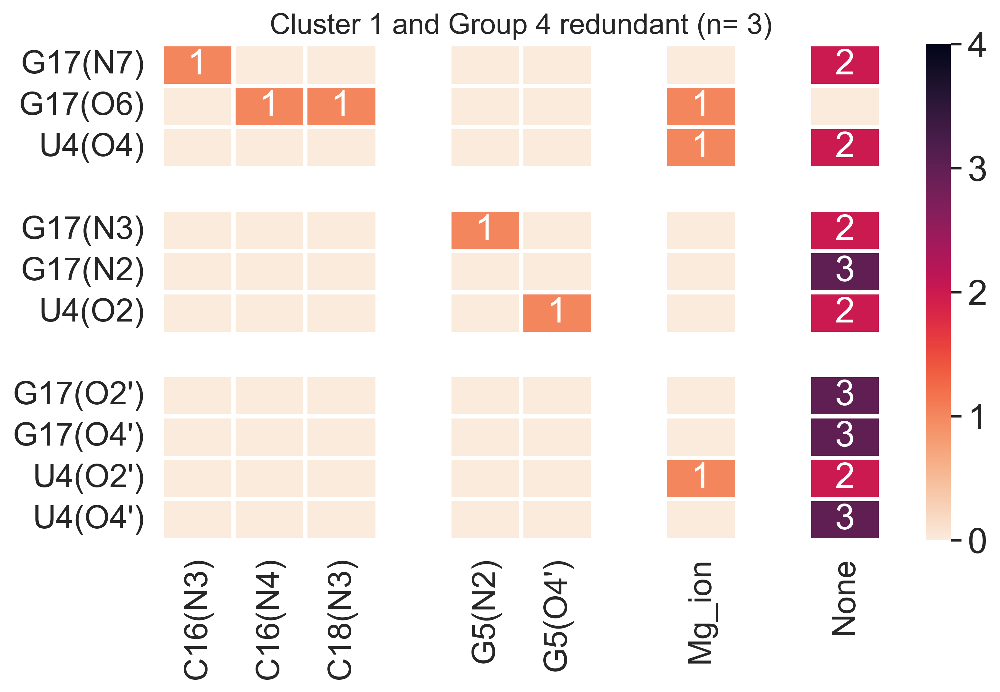

In [97]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (9,5), dpi = 400)
sns.set(font_scale=1.8)

C1_4_all_2.replace('None', np.nan, inplace=True)
C1_4_all_2 = C1_4_all_2.apply(pd.to_numeric)

annotations = C1_4_all_2.where((C1_4_all_2 != 0) & C1_4_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C1_4_all_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 1 and Group 4 redundant (n= 3)", fontsize=16)

In [92]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (9,5), dpi = 1400)
sns.set(font_scale=1.8)

C1_4_nr_2.replace('None', np.nan, inplace=True)
C1_4_nr_2 = C1_4_nr_2.apply(pd.to_numeric)

annotations = C1_4_nr_2.where((C1_4_nr_2 != 0) & C1_4_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C1_4_nr_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 1 and Group 4 non-redundant", fontsize=16)

Text(0.5, 1.0, 'Cluster 1 and Group 4 non-redundant')

## Cluster 1 and Group 12

In [93]:
#cluster 1 --> group ID: 12
C1_12_all= sw_df1[(sw_df1['red_group_ID']==12)]
C1_12_all.index= np.arange(0, len(C1_12_all))

C1_12_nr= sw_df1[(sw_df1['red_group_ID']==12) & (sw_df1['representative']==1)]
C1_12_nr.index= np.arange(0, len(C1_12_nr))

In [94]:
C1_12_all_1= count_tert_intr(C1_12_all)
C1_12_nr_1= count_tert_intr(C1_12_nr)

working here
7RQB
1099
1086
working here
4B3R
1099
1086
working here
5FDU
1099
1086
working here
2UXB
1099
1086
working here
6QNR
1099
1086
working here
1XNR
1099
1086
working here
5WIT
1099
1086
working here
5VP2
1099
1086
G_N7_interactions
{'C18(N4)': 1, 'C16(N4)': 1, 'C16(N3)': 7}
G_O6_interactions
{'C16(N4)': 2, 'MG_LR(MG)': 5, 'C18(N3)': 5, 'G5(O6)': 1, 'C18(N4)': 3}
U_O4_interactions
{'MG_LR(MG)': 5, 'C18(O2)': 1, 'None': 2, 'U3(OP2)': 2}
G_N3_interactions
{'None': 5, 'G5(N1)': 3, 'G5(N2)': 1}
G_N2_interactions
{'None': 7, 'C18(O2)': 1}
U_O2_interactions
{'None': 5, 'G2(OP1)': 3}
G_O4s_interactions
{'None': 3, "C16(O2')": 4, 'C16(O2)': 1}
G_O2s_interactions
{'None': 8}
U_O4s_interactions
{'None': 6, 'MG_LR(MG)': 1, 'G2(OP2)': 1}
U_O2s_interactions
{'None': 8}
******************************************************
['17', '17', '17', '17', '17', '17', '17', '17']
['4', '4', '4', '4', '4', '4', '4', '4']
{'G17(N7)': {'C18(N4)': 1, 'C16(N4)': 1, 'C16(N3)': 7}, 'G17(O6)': {'C16(N4)': 

In [95]:
C1_12_all_2= add_aditional_cols(C1_12_all_1)
C1_12_nr_2= add_aditional_cols(C1_12_nr_1)

check here
Index(['C18(N4)', 'C16(N4)', 'C16(N3)', 'MG_LR(MG)', 'C18(N3)', 'G5(O6)',
       'C18(O2)', 'None', 'U3(OP2)', 'G5(N1)', 'G5(N2)', 'G2(OP1)', 'C16(O2')',
       'C16(O2)', 'G2(OP2)'],
      dtype='object')
['MG_LR(MG)']
['None']
         C16(O2') C16(O2) C16(N3) C16(N4) C18(O2) C18(N3) C18(N4)     G2(OP1)  \
G17(N7)         0       0     7.0     1.0       0       0     1.0 NaN       0   
G17(O6)         0       0       0     2.0       0     5.0     3.0 NaN       0   
U4(O4)          0       0       0       0     1.0       0       0 NaN       0   
0             NaN     NaN     NaN     NaN     NaN     NaN     NaN NaN     NaN   
G17(N3)         0       0       0       0       0       0       0 NaN       0   
G17(N2)         0       0       0       0     1.0       0       0 NaN       0   
U4(O2)          0       0       0       0       0       0       0 NaN     3.0   
0             NaN     NaN     NaN     NaN     NaN     NaN     NaN NaN     NaN   
G17(O2')        0       0      

Text(0.5, 1.0, 'Cluster 1 and Group 12 redundant (n= 8)')

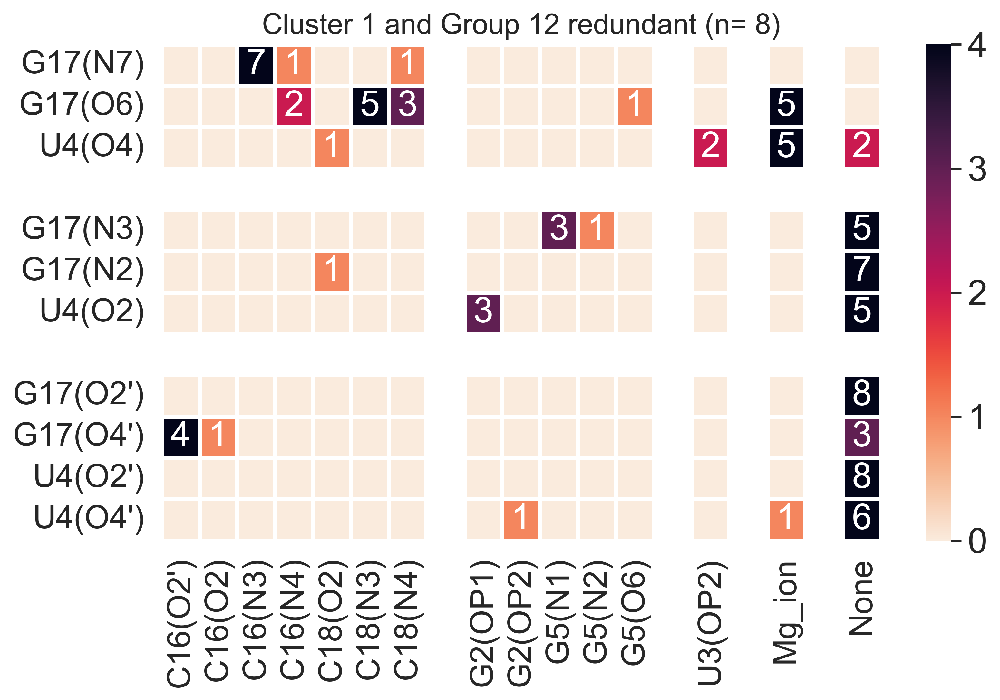

In [101]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (9,5), dpi = 400)
sns.set(font_scale=1.8)

C1_12_all_2.replace('None', np.nan, inplace=True)
C1_12_all_2 = C1_12_all_2.apply(pd.to_numeric)

annotations = C1_12_all_2.where((C1_12_all_2 != 0) & C1_12_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C1_12_all_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 1 and Group 12 redundant (n= 8)", fontsize=16)

Text(0.5, 1.0, 'Cluster 1 and Group 12 non-redundant')

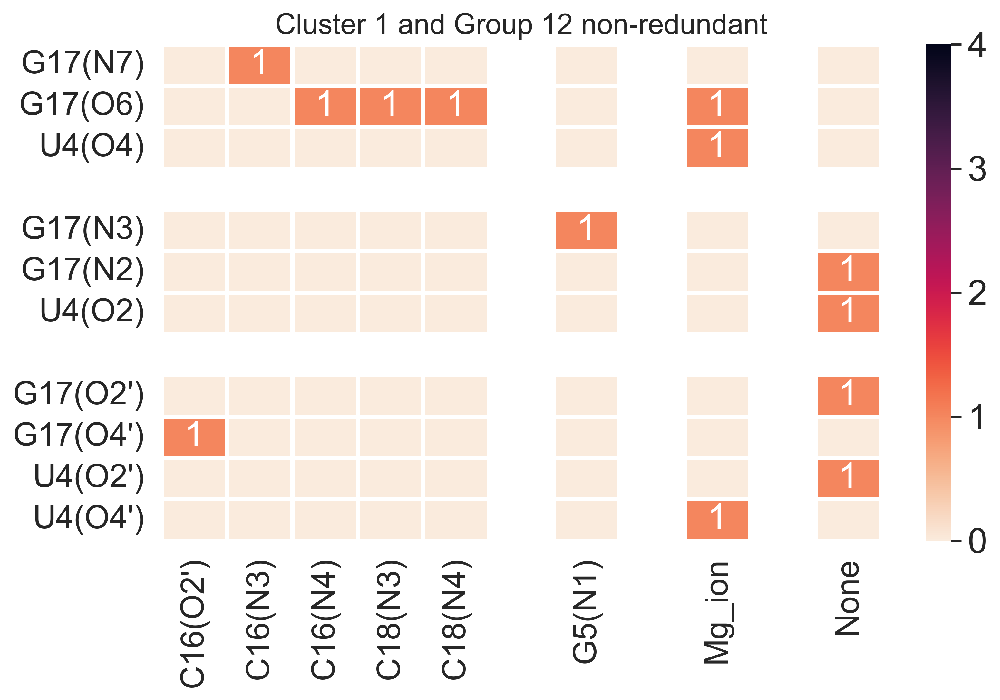

In [103]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (9,5), dpi = 400)
sns.set(font_scale=1.8)

C1_12_nr_2.replace('None', np.nan, inplace=True)
C1_12_nr_2 = C1_12_nr_2.apply(pd.to_numeric)

annotations = C1_12_nr_2.where((C1_12_nr_2 != 0) & C1_12_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C1_12_nr_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 1 and Group 12 non-redundant", fontsize=16)

# Cluster 2

## Cluster 2 and Group 2

In [111]:
#cluster 2 --> group ID: 2
C2_2_all= sw_df1[(sw_df1['red_group_ID']==2)]
C2_2_all.index= np.arange(0, len(C2_2_all))

C2_2_nr= sw_df1[(sw_df1['red_group_ID']==2) & (sw_df1['representative']==1)]
C2_2_nr.index= np.arange(0, len(C2_2_nr))

In [106]:
C2_2_all_1= count_tert_intr(C2_2_all)
C2_2_nr_1= count_tert_intr(C2_2_nr)

working here
7UVY
710
674
working here
7UW1
710
674
working here
7UVZ
710
674
G_N7_interactions
{'None': 3}
G_O6_interactions
{'A39(N6)': 3}
U_O4_interactions
{'U5(O4)': 3, 'A3(N1)': 2}
G_N3_interactions
{'None': 3}
G_N2_interactions
{"A_LR(O2')": 3}
U_O2_interactions
{"A_LR(O2')": 3}
G_O4s_interactions
{"A39(O2')": 3}
G_O2s_interactions
{"G41(O4')": 3}
U_O4s_interactions
{"A3(O2')": 3}
U_O2s_interactions
{'None': 3}
******************************************************
['40', '40', '40']
['4', '4', '4']
{'G40(N7)': {'None': 3}, 'G40(O6)': {'A39(N6)': 3}, 'U4(O4)': {'U5(O4)': 3, 'A3(N1)': 2}, 'G40(N3)': {'None': 3}, 'G40(N2)': {"A_LR(O2')": 3}, 'U4(O2)': {"A_LR(O2')": 3}, "G40(O2')": {"G41(O4')": 3}, "G40(O4')": {"A39(O2')": 3}, "U4(O2')": {'None': 3}, "U4(O4')": {"A3(O2')": 3}}
          None  A39(N6)  U5(O4)  A3(N1)  A_LR(O2')  G41(O4')  A39(O2')  \
G40(N7)    3.0      NaN     NaN     NaN        NaN       NaN       NaN   
G40(O6)    NaN      3.0     NaN     NaN        NaN       NaN 

In [108]:
C2_2_all_2= add_aditional_cols(C2_2_all_1)
C2_2_nr_2= add_aditional_cols(C2_2_nr_1)

check here
Index(['None', 'A39(N6)', 'U5(O4)', 'A3(N1)', 'A_LR(O2')', 'G41(O4')',
       'A39(O2')', 'A3(O2')'],
      dtype='object')
[]
['None']
         A3(N1) A3(O2') A39(O2') A39(N6)     G41(O4')     U5(O4)       \
G40(N7)       0       0        0       0 NaN        0 NaN      0  NaN   
G40(O6)       0       0        0     3.0 NaN        0 NaN      0  NaN   
U4(O4)      2.0       0        0       0 NaN        0 NaN    3.0  NaN   
0           NaN     NaN      NaN     NaN NaN      NaN NaN    NaN  NaN   
G40(N3)       0       0        0       0 NaN        0 NaN      0  NaN   
G40(N2)       0       0        0       0 NaN        0 NaN      0  NaN   
U4(O2)        0       0        0       0 NaN        0 NaN      0  NaN   
0           NaN     NaN      NaN     NaN NaN      NaN NaN    NaN  NaN   
G40(O2')      0       0        0       0 NaN      3.0 NaN      0  NaN   
G40(O4')      0       0      3.0       0 NaN        0 NaN      0  NaN   
U4(O2')       0       0        0       0 NaN      

Text(0.5, 1.0, 'Cluster 2 and Group 2 redundant (n=3)')

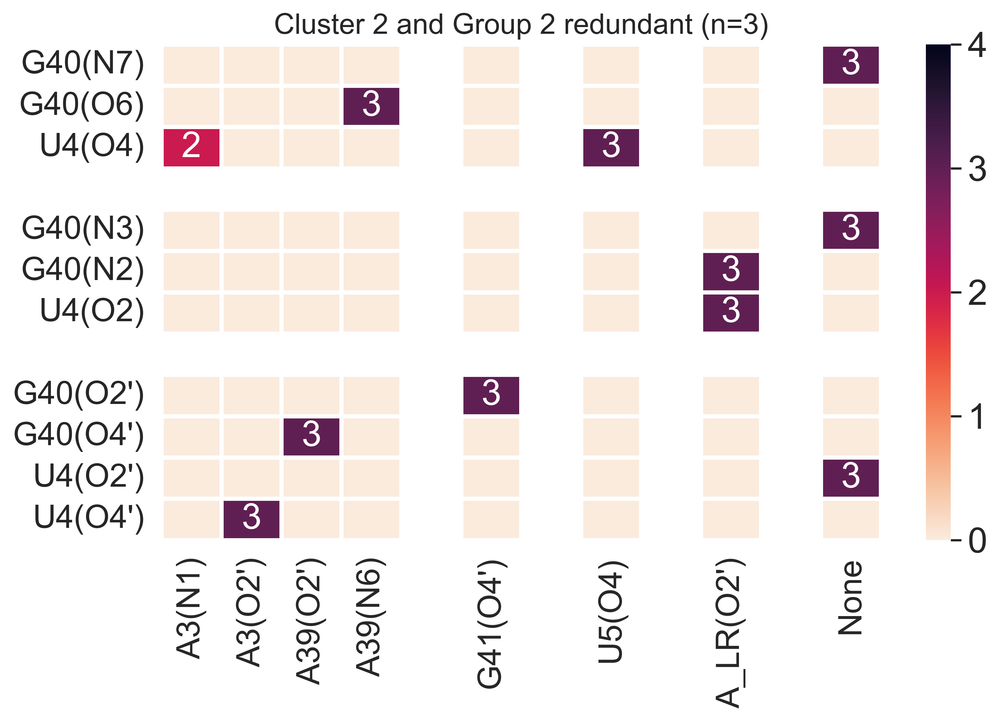

In [109]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (9,5), dpi = 400)
sns.set(font_scale=1.8)

C2_2_all_2.replace('None', np.nan, inplace=True)
C2_2_all_2 = C2_2_all_2.apply(pd.to_numeric)

annotations = C2_2_all_2.where((C2_2_all_2 != 0) & C2_2_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_2_all_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 2 and Group 2 redundant (n=3)", fontsize=16)

Text(0.5, 1.0, 'Cluster 2 and Group 2 non-redundant')

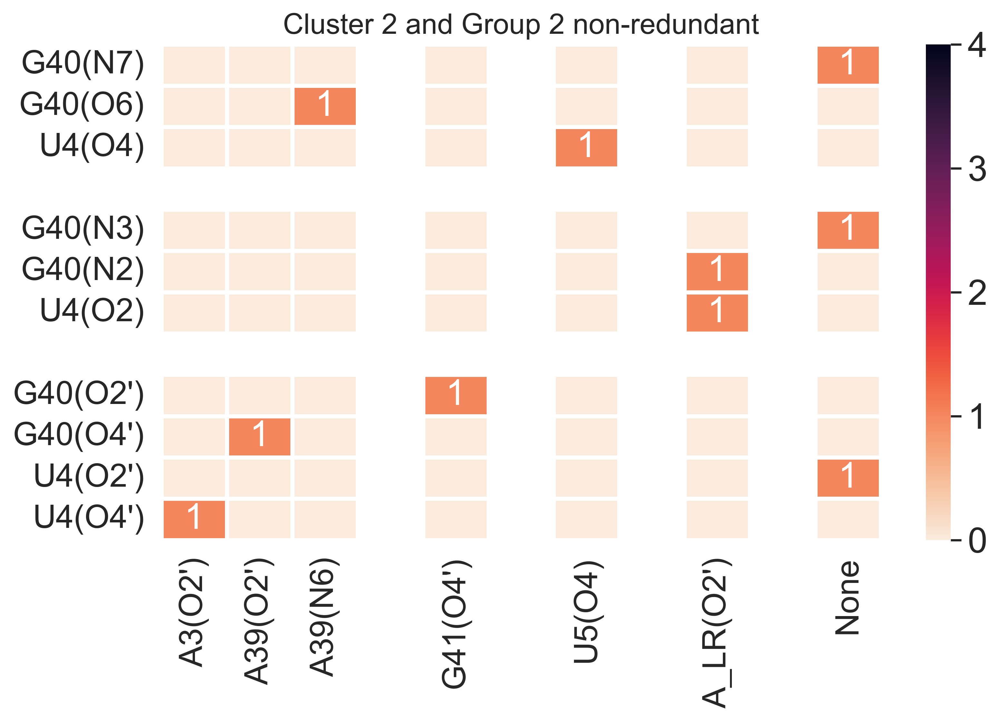

In [110]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (9,5), dpi = 400)
sns.set(font_scale=1.8)

C2_2_nr_2.replace('None', np.nan, inplace=True)
C2_2_nr_2 = C2_2_nr_2.apply(pd.to_numeric)

annotations = C2_2_nr_2.where((C2_2_nr_2 != 0) & C2_2_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_2_nr_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 2 and Group 2 non-redundant", fontsize=16)

## Cluster 2 and Group 5

In [194]:
#cluster 2 --> group ID: 5
C2_5_all= sw_long_df1[(sw_long_df1['red_group_ID']==5)]
C2_5_all.index= np.arange(0, len(C2_5_all))

C2_5_nr= sw_long_df1[(sw_long_df1['red_group_ID']==5) & (sw_long_df1['representative']==1)]
C2_5_nr.index= np.arange(0, len(C2_5_nr))

In [195]:
C2_5_all_1= count_tert_intr(C2_5_all)
C2_5_nr_1= count_tert_intr(C2_5_nr)

working here
6ZU1
713
677
working here
5AFI
713
677
working here
5NWY
713
677
working here
4WWW
713
677
working here
7NWT
713
677
working here
6TC3
713
677
working here
7B5K
713
677
working here
7S1J
713
677
working here
7K00
713
677
working here
7SA4
713
677
working here
7O1A
713
677
working here
4V9P
713
677
working here
8B0X
713
677
working here
7NSO
713
677
working here
7OT5
713
677
working here
4V9O
713
677
working here
4V7U
713
677
working here
7ST2
713
677
working here
7PJV
713
677
working here
6XZA
713
677
working here
7PJY
713
677
working here
7NWW
713
677
working here
7SSO
713
677
working here
4U26
713
677
working here
6ZTO
713
677
working here
4WF1
713
677
working here
4YBB
713
677
working here
7BOG
713
677
working here
6Y69
713
677
working here
6XZB
713
677
working here
7O19
713
677
working here
7N2V
713
677
working here
4U24
713
677
working here
7ZTA
713
677
working here
6YSR
713
677
working here
7BOH
713
677
working here
4U25
713
677
working here
7N1P
713
677
working here

In [196]:
C2_5_all_2= add_aditional_cols(C2_5_all_1)
C2_5_nr_2= add_aditional_cols(C2_5_nr_1)

check here
Index(['A39(N7)', 'None', 'HOH_LR(O)', 'A3(N6)', 'U4(O4)', 'MG_LR(MG)',
       'A39(N6)', 'G41(O6)', 'A3(N1)', 'U5(O4)', 'G40(O6)', 'U5(N3)',
       'G41(N1)', 'A39(N3)', 'A39(N1)', 'G41(N2)', 'A_LR(O2')', 'A_LR(O4')',
       'G41(N3)', 'U5(O2)', 'U4(O2)', 'Cys(SG)', 'U5(O4')', 'U5(N1)',
       'G40(N2)', 'G_LR(OP1)', 'G41(P)', 'G41(O4')', 'G41(O5')', 'A39(O3')',
       'A39(O2')', 'U5(O5')', 'U5(P)', 'A3(O2')'],
      dtype='object')
['MG_LR(MG)']
['HOH_LR(O)', '       ', 'None']
         A3(N1) A3(O2') A3(N6) A39(N1) A39(O2') A39(N3) A39(O3') A39(N6)  \
G40(N7)       0       0      0       0        0       0        0       0   
G40(O6)       0       0   14.0       0        0       0        0    47.0   
U4(O4)     46.0       0   46.0       0        0       0        0     1.0   
0           NaN     NaN    NaN     NaN      NaN     NaN      NaN     NaN   
G40(N3)       0       0      0    32.0        0     1.0        0       0   
G40(N2)       0       0      0    10.0        0

Text(0.5, 1.0, 'Cluster 2 and Group 5 redundant (n=47)')

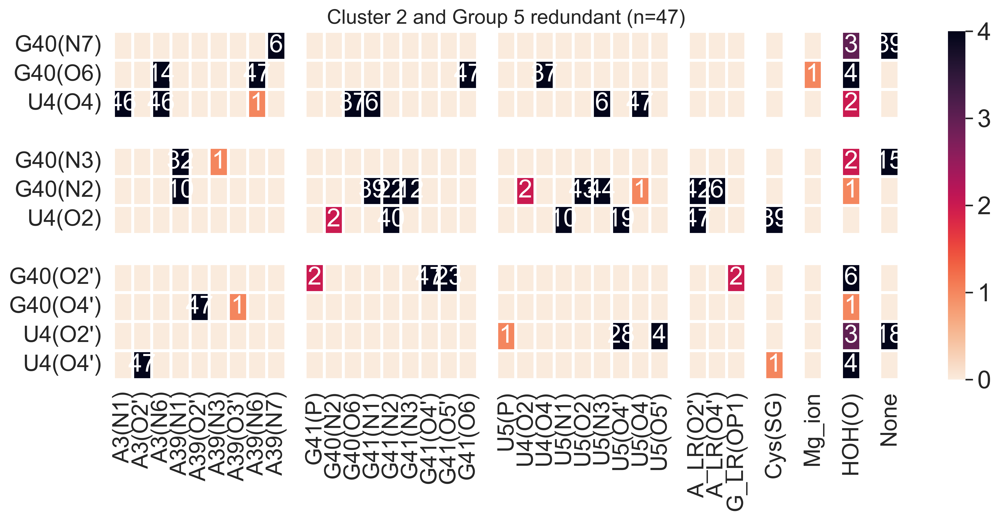

In [197]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (14,5), dpi = 400)
sns.set(font_scale=1.8)

C2_5_all_2.replace('None', np.nan, inplace=True)
C2_5_all_2 = C2_5_all_2.apply(pd.to_numeric)

annotations = C2_5_all_2.where((C2_5_all_2 != 0) & C2_5_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_5_all_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 2 and Group 5 redundant (n=47)", fontsize=16)

Text(0.5, 1.0, 'Cluster 2 and Group 5 non-redundant')

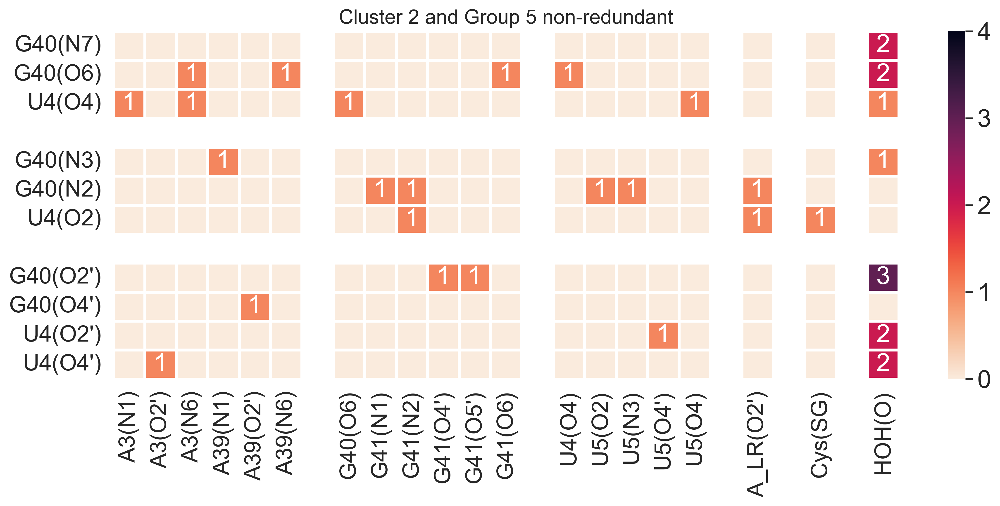

In [198]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (14,5), dpi = 400)
sns.set(font_scale=1.8)

C2_5_nr_2.replace('None', np.nan, inplace=True)
C2_5_nr_2 = C2_5_nr_2.apply(pd.to_numeric)

annotations = C2_5_nr_2.where((C2_5_nr_2 != 0) & C2_5_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_5_nr_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 2 and Group 5 non-redundant", fontsize=16)

# Cluster 2 and Group 7

In [120]:
#cluster 2 --> group ID: 7
C2_7_all= sw_df1[(sw_df1['red_group_ID']==7)]
C2_7_all.index= np.arange(0, len(C2_7_all))

C2_7_nr= sw_df1[(sw_df1['red_group_ID']==7) & (sw_df1['representative']==1)]
C2_7_nr.index= np.arange(0, len(C2_7_nr))

In [121]:
C2_7_all_1= count_tert_intr(C2_7_all)
C2_7_nr_1= count_tert_intr(C2_7_nr)

working here
7MT7
704
668
working here
7MT3
704
668
working here
7KGB
704
668
G_N7_interactions
{'None': 3}
G_O6_interactions
{'A39(N6)': 3, 'G41(O6)': 1}
U_O4_interactions
{'A3(N6)': 2, 'U5(O4)': 3, 'A3(N1)': 1}
G_N3_interactions
{'None': 3}
G_N2_interactions
{'None': 2, 'U5(O2)': 1}
U_O2_interactions
{"A_LR(O2')": 3, 'G41(N2)': 2}
G_O4s_interactions
{'None': 1, "A39(O2')": 2}
G_O2s_interactions
{"G41(O4')": 3}
U_O4s_interactions
{'None': 2, "A3(O2')": 1}
U_O2s_interactions
{'None': 3}
******************************************************
['40', '40', '40']
['4', '4', '4']
{'G40(N7)': {'None': 3}, 'G40(O6)': {'A39(N6)': 3, 'G41(O6)': 1}, 'U4(O4)': {'A3(N6)': 2, 'U5(O4)': 3, 'A3(N1)': 1}, 'G40(N3)': {'None': 3}, 'G40(N2)': {'None': 2, 'U5(O2)': 1}, 'U4(O2)': {"A_LR(O2')": 3, 'G41(N2)': 2}, "G40(O2')": {"G41(O4')": 3}, "G40(O4')": {'None': 1, "A39(O2')": 2}, "U4(O2')": {'None': 3}, "U4(O4')": {'None': 2, "A3(O2')": 1}}
          None  A39(N6)  G41(O6)  A3(N6)  U5(O4)  A3(N1)  U5(O2)  A

In [122]:
C2_7_all_2= add_aditional_cols(C2_7_all_1)
C2_7_nr_2= add_aditional_cols(C2_7_nr_1)

check here
Index(['None', 'A39(N6)', 'G41(O6)', 'A3(N6)', 'U5(O4)', 'A3(N1)', 'U5(O2)',
       'A_LR(O2')', 'G41(N2)', 'G41(O4')', 'A39(O2')', 'A3(O2')'],
      dtype='object')
[]
['None']
         A3(N1) A3(O2') A3(N6) A39(O2') A39(N6)     G41(N2) G41(O4') G41(O6)  \
G40(N7)       0       0      0        0       0 NaN       0        0       0   
G40(O6)       0       0      0        0     3.0 NaN       0        0     1.0   
U4(O4)      1.0       0    2.0        0       0 NaN       0        0       0   
0           NaN     NaN    NaN      NaN     NaN NaN     NaN      NaN     NaN   
G40(N3)       0       0      0        0       0 NaN       0        0       0   
G40(N2)       0       0      0        0       0 NaN       0        0       0   
U4(O2)        0       0      0        0       0 NaN     2.0        0       0   
0           NaN     NaN    NaN      NaN     NaN NaN     NaN      NaN     NaN   
G40(O2')      0       0      0        0       0 NaN       0      3.0       0   
G40(O4')   

Text(0.5, 1.0, 'Cluster 2 and Group 7 redundant (n=3)')

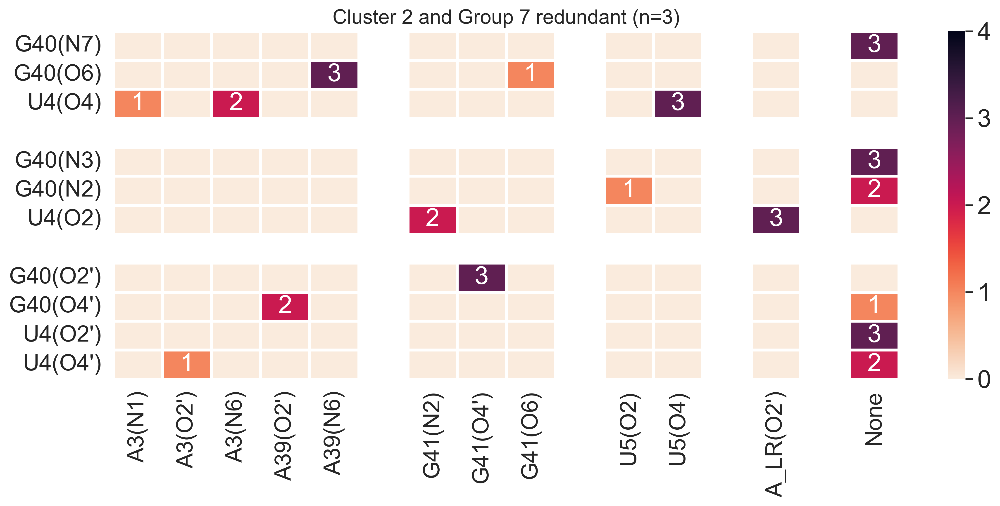

In [123]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (14,5), dpi = 400)
sns.set(font_scale=1.8)

C2_7_all_2.replace('None', np.nan, inplace=True)
C2_7_all_2 = C2_7_all_2.apply(pd.to_numeric)

annotations = C2_7_all_2.where((C2_7_all_2 != 0) & C2_7_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_7_all_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 2 and Group 7 redundant (n=3)", fontsize=16)

Text(0.5, 1.0, 'Cluster 2 and Group 7 non-redundant')

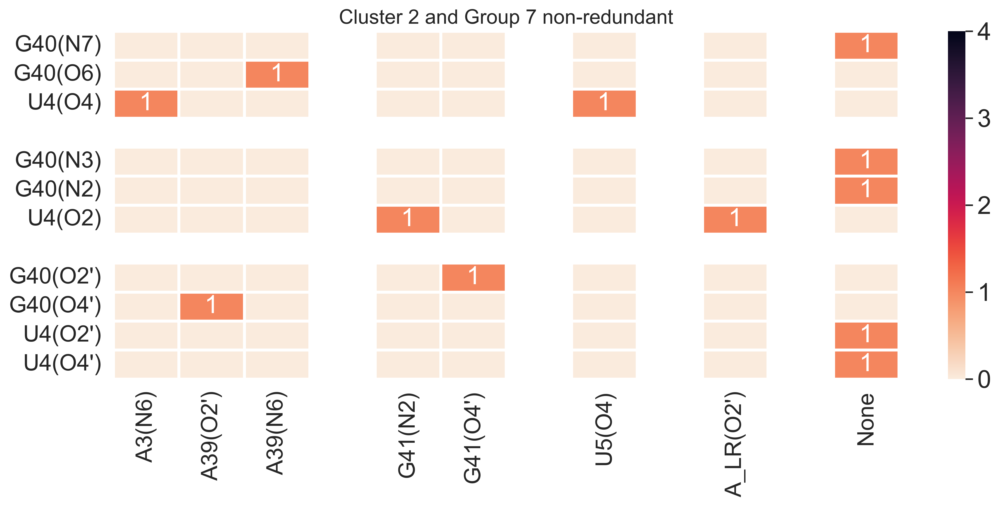

In [124]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (14,5), dpi = 400)
sns.set(font_scale=1.8)

C2_7_nr_2.replace('None', np.nan, inplace=True)
C2_7_nr_2 = C2_7_nr_2.apply(pd.to_numeric)

annotations = C2_7_nr_2.where((C2_7_nr_2 != 0) & C2_7_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_7_nr_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 2 and Group 7 non-redundant", fontsize=16)

## Cluster 2 and Group 9

In [130]:
#cluster 2 --> group ID: 9
C2_9_all= sw_df1[(sw_df1['red_group_ID']==9)]
C2_9_all.index= np.arange(0, len(C2_9_all))

C2_9_nr= sw_df1[(sw_df1['red_group_ID']==9) & (sw_df1['representative']==1)]
C2_9_nr.index= np.arange(0, len(C2_9_nr))

In [131]:
C2_9_all_1= count_tert_intr(C2_9_all)
C2_9_nr_1= count_tert_intr(C2_9_nr)

working here
7UNR
707
671
working here
7UNW
707
671
G_N7_interactions
{'None': 2}
G_O6_interactions
{'A39(N6)': 2}
U_O4_interactions
{'A3(N6)': 1, 'U5(O4)': 2}
G_N3_interactions
{'None': 2}
G_N2_interactions
{'None': 2}
U_O2_interactions
{"A_LR(O2')": 2}
G_O4s_interactions
{"A39(O2')": 2}
G_O2s_interactions
{"G41(O4')": 2}
U_O4s_interactions
{'None': 1, "A3(O2')": 1}
U_O2s_interactions
{'None': 2}
******************************************************
['40', '40']
['4', '4']
{'G40(N7)': {'None': 2}, 'G40(O6)': {'A39(N6)': 2}, 'U4(O4)': {'A3(N6)': 1, 'U5(O4)': 2}, 'G40(N3)': {'None': 2}, 'G40(N2)': {'None': 2}, 'U4(O2)': {"A_LR(O2')": 2}, "G40(O2')": {"G41(O4')": 2}, "G40(O4')": {"A39(O2')": 2}, "U4(O2')": {'None': 2}, "U4(O4')": {'None': 1, "A3(O2')": 1}}
          None  A39(N6)  A3(N6)  U5(O4)  A_LR(O2')  G41(O4')  A39(O2')  \
G40(N7)    2.0      NaN     NaN     NaN        NaN       NaN       NaN   
G40(O6)    NaN      2.0     NaN     NaN        NaN       NaN       NaN   
U4(O4)     N

In [127]:
C2_9_all_2= add_aditional_cols(C2_9_all_1)
C2_9_nr_2= add_aditional_cols(C2_9_nr_1)

check here
Index(['None', 'A39(N6)', 'A3(N6)', 'U5(O4)', 'A_LR(O2')', 'G41(O4')',
       'A39(O2')', 'A3(O2')'],
      dtype='object')
[]
['None']
         A3(O2') A3(N6) A39(O2') A39(N6)     G41(O4')     U5(O4)       \
G40(N7)        0      0        0       0 NaN        0 NaN      0  NaN   
G40(O6)        0      0        0     2.0 NaN        0 NaN      0  NaN   
U4(O4)         0    1.0        0       0 NaN        0 NaN    2.0  NaN   
0            NaN    NaN      NaN     NaN NaN      NaN NaN    NaN  NaN   
G40(N3)        0      0        0       0 NaN        0 NaN      0  NaN   
G40(N2)        0      0        0       0 NaN        0 NaN      0  NaN   
U4(O2)         0      0        0       0 NaN        0 NaN      0  NaN   
0            NaN    NaN      NaN     NaN NaN      NaN NaN    NaN  NaN   
G40(O2')       0      0        0       0 NaN      2.0 NaN      0  NaN   
G40(O4')       0      0      2.0       0 NaN        0 NaN      0  NaN   
U4(O2')        0      0        0       0 NaN      

Text(0.5, 1.0, 'Cluster 2 and Group 9 redundant (n=2)')

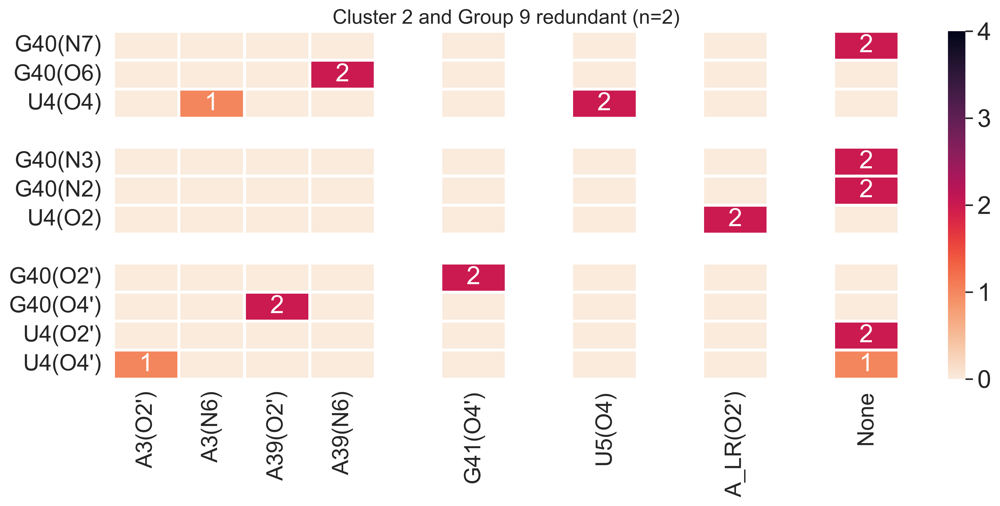

In [132]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (14,5), dpi = 400)
sns.set(font_scale=1.8)

C2_9_all_2.replace('None', np.nan, inplace=True)
C2_9_all_2 = C2_9_all_2.apply(pd.to_numeric)

annotations = C2_9_all_2.where((C2_9_all_2 != 0) & C2_9_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_9_all_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 2 and Group 9 redundant (n=2)", fontsize=16)

Text(0.5, 1.0, 'Cluster 2 and Group 9 non-redundant')

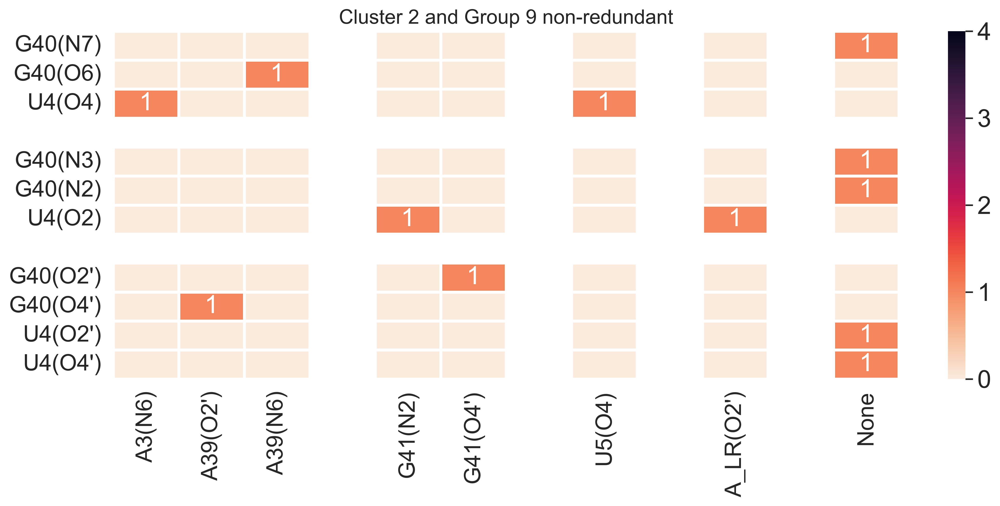

In [133]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (14,5), dpi = 400)
sns.set(font_scale=1.8)

C2_9_nr_2.replace('None', np.nan, inplace=True)
C2_9_nr_2 = C2_9_nr_2.apply(pd.to_numeric)

annotations = C2_9_nr_2.where((C2_9_nr_2 != 0) & C2_9_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_9_nr_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 2 and Group 9 non-redundant", fontsize=16)

## Cluster 2 and Group 11

In [134]:
#cluster 2 --> group ID: 11
C2_11_all= sw_df1[(sw_df1['red_group_ID']==11)]
C2_11_all.index= np.arange(0, len(C2_11_all))

C2_11_nr= sw_df1[(sw_df1['red_group_ID']==11) & (sw_df1['representative']==1)]
C2_11_nr.index= np.arange(0, len(C2_11_nr))

In [135]:
C2_11_all_1= count_tert_intr(C2_11_all)
C2_11_nr_1= count_tert_intr(C2_11_nr)

working here
5NGM
721
685
working here
6YEF
721
685
G_N7_interactions
{'None': 2}
G_O6_interactions
{'A39(N6)': 2, 'G41(O6)': 2}
U_O4_interactions
{'A3(N6)': 1, 'U5(O4)': 2}
G_N3_interactions
{'None': 2}
G_N2_interactions
{'U5(N3)': 2, 'U5(O2)': 1}
U_O2_interactions
{"A_LR(O2')": 2, 'G41(N2)': 2}
G_O4s_interactions
{'None': 2}
G_O2s_interactions
{"G41(O4')": 2}
U_O4s_interactions
{'None': 2}
U_O2s_interactions
{'None': 2}
******************************************************
['40', '40']
['4', '4']
{'G40(N7)': {'None': 2}, 'G40(O6)': {'A39(N6)': 2, 'G41(O6)': 2}, 'U4(O4)': {'A3(N6)': 1, 'U5(O4)': 2}, 'G40(N3)': {'None': 2}, 'G40(N2)': {'U5(N3)': 2, 'U5(O2)': 1}, 'U4(O2)': {"A_LR(O2')": 2, 'G41(N2)': 2}, "G40(O2')": {"G41(O4')": 2}, "G40(O4')": {'None': 2}, "U4(O2')": {'None': 2}, "U4(O4')": {'None': 2}}
          None  A39(N6)  G41(O6)  A3(N6)  U5(O4)  U5(N3)  U5(O2)  A_LR(O2')  \
G40(N7)    2.0      NaN      NaN     NaN     NaN     NaN     NaN        NaN   
G40(O6)    NaN      2.0   

In [136]:
C2_11_all_2= add_aditional_cols(C2_11_all_1)
C2_11_nr_2= add_aditional_cols(C2_11_nr_1)

check here
Index(['None', 'A39(N6)', 'G41(O6)', 'A3(N6)', 'U5(O4)', 'U5(N3)', 'U5(O2)',
       'A_LR(O2')', 'G41(N2)', 'G41(O4')'],
      dtype='object')
[]
['None']
         A3(N6) A39(N6)     G41(N2) G41(O4') G41(O6)     U5(O2) U5(N3) U5(O4)  \
G40(N7)       0       0 NaN       0        0       0 NaN      0      0      0   
G40(O6)       0     2.0 NaN       0        0     2.0 NaN      0      0      0   
U4(O4)      1.0       0 NaN       0        0       0 NaN      0      0    2.0   
0           NaN     NaN NaN     NaN      NaN     NaN NaN    NaN    NaN    NaN   
G40(N3)       0       0 NaN       0        0       0 NaN      0      0      0   
G40(N2)       0       0 NaN       0        0       0 NaN    1.0    2.0      0   
U4(O2)        0       0 NaN     2.0        0       0 NaN      0      0      0   
0           NaN     NaN NaN     NaN      NaN     NaN NaN    NaN    NaN    NaN   
G40(O2')      0       0 NaN       0      2.0       0 NaN      0      0      0   
G40(O4')      0       0 

Text(0.5, 1.0, 'Cluster 2 and Group 11 redundant (n=2)')

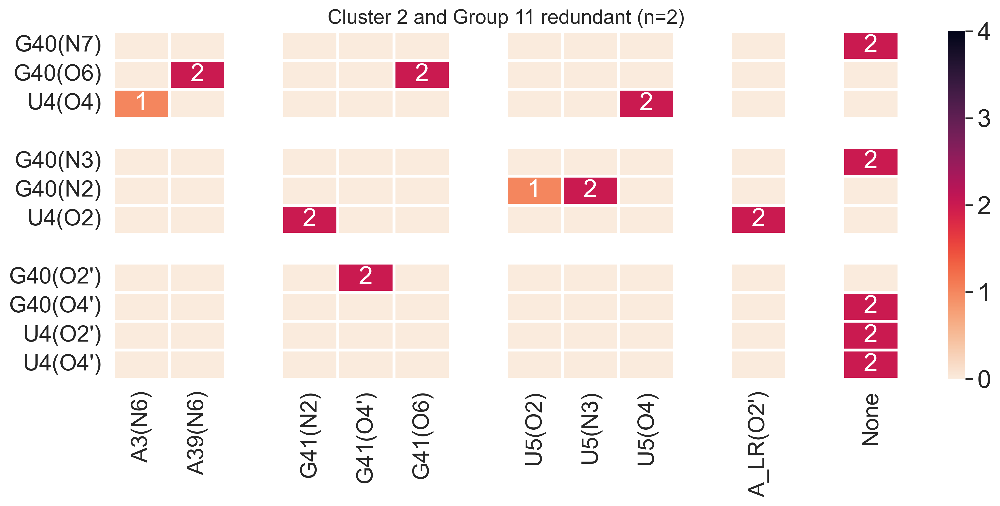

In [137]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (14,5), dpi = 400)
sns.set(font_scale=1.8)

C2_11_all_2.replace('None', np.nan, inplace=True)
C2_11_all_2 = C2_11_all_2.apply(pd.to_numeric)

annotations = C2_11_all_2.where((C2_11_all_2 != 0) & C2_11_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_11_all_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 2 and Group 11 redundant (n=2)", fontsize=16)

Text(0.5, 1.0, 'Cluster 2 and Group 11 non-redundant')

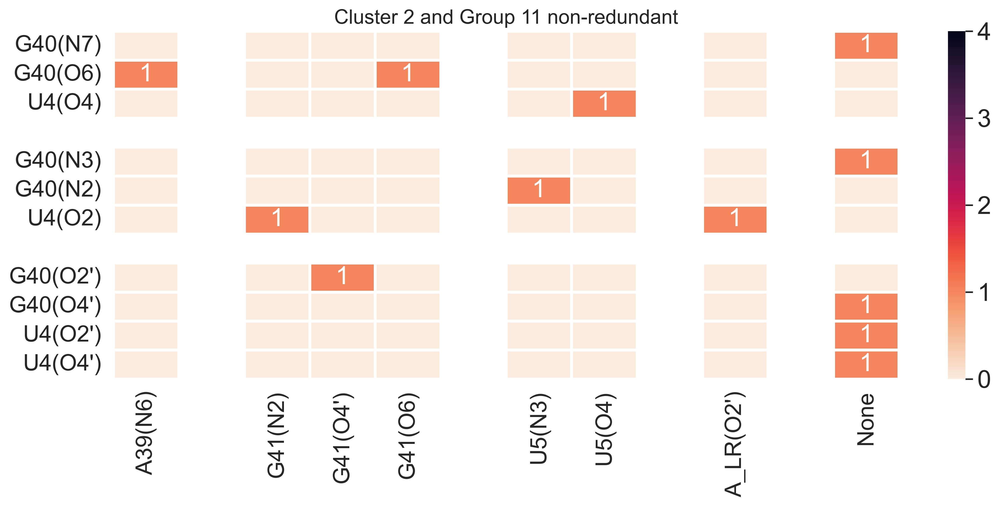

In [138]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (14,5), dpi = 400)
sns.set(font_scale=1.8)

C2_11_nr_2.replace('None', np.nan, inplace=True)
C2_11_nr_2 = C2_11_nr_2.apply(pd.to_numeric)

annotations = C2_11_nr_2.where((C2_11_nr_2 != 0) & C2_11_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_11_nr_2,annot= annotations, fmt='', annot_kws={"size": 20, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 2 and Group 11 non-redundant", fontsize=16)

## Cluster 2 and Group 13

In [139]:
#cluster 2 --> group ID: 11
C2_13_all= sw_df1[(sw_df1['red_group_ID']==13)]
C2_13_all.index= np.arange(0, len(C2_13_all))

C2_13_nr= sw_df1[(sw_df1['red_group_ID']==13) & (sw_df1['representative']==1)]
C2_13_nr.index= np.arange(0, len(C2_13_nr))

In [140]:
C2_13_all_1= count_tert_intr(C2_13_all)
C2_13_nr_1= count_tert_intr(C2_13_nr)

working here
7RQB
713
677
working here
7RQB
713
677
working here
4WQY
713
677
working here
4WQY
713
677
working here
6CFJ
713
677
working here
6CFJ
713
677
working here
7JQL
713
677
working here
5DOY
713
677
working here
4Y4O
713
677
working here
4Y4O
713
677
working here
4V87
713
677
working here
4V87
713
677
working here
4LNT
713
677
working here
4LNT
713
677
working here
8CVJ
713
677
working here
8CVJ
713
677
working here
7RQ8
713
677
working here
4WPO
713
677
working here
4WPO
713
677
working here
5J4C
713
677
working here
5J4C
713
677
working here
4V8I
713
677
working here
4V8I
713
677
working here
5EL7
713
677
working here
6XHX
713
677
working here
5HAU
697
661
working here
5HAU
697
661
working here
4V8B
713
677
working here
1VY4
713
677
working here
4YZV
713
677
working here
4V51
713
677
working here
4V51
713
677
working here
6OF1
713
677
working here
5NDK
1342
1306
working here
4WSD
713
677
working here
4WSD
713
677
working here
4V95
713
677
working here
6O97
713
677
working he

In [141]:
C2_13_all_2= add_aditional_cols(C2_13_all_1)
C2_13_nr_2= add_aditional_cols(C2_13_nr_1)

check here
Index(['Ohx(N1)', 'MG_LR(MG)', 'HOH_LR(O)', 'Ohx(N6)', 'None', 'Ohx(N3)',
       'A3(N6)', 'A39(N6)', 'G41(O6)', 'A3(N1)', 'U5(O4)', 'A39(N1)',
       'G41(N2)', 'A_LR(O2')', 'A_LR(O4')', 'U5(N3)', 'G41(N3)', 'U5(O2)',
       'G41(N1)', 'Cys(SG)', 'G41(O4')', 'G41(O5')', 'G_LR(OP1)', 'A39(O2')',
       'U5(O4')', 'U5(O5')', 'A3(O2')'],
      dtype='object')
['MG_LR(MG)']
['HOH_LR(O)', '       ', 'None']
         A3(N1) A3(O2') A3(N6) A39(N1) A39(O2') A39(N6)     G41(N1) G41(N2)  \
G40(N7)       0       0      0       0        0       0 NaN       0       0   
G40(O6)       0       0    2.0       0        0   130.0 NaN       0       0   
U4(O4)     69.0       0  105.0       0        0       0 NaN       0       0   
0           NaN     NaN    NaN     NaN      NaN     NaN NaN     NaN     NaN   
G40(N3)       0       0      0     3.0        0       0 NaN       0       0   
G40(N2)       0       0      0       0        0       0 NaN    64.0    53.0   
U4(O2)        0       0      

Text(0.5, 1.0, 'Cluster 2 and Group 13 redundant (n=137)')

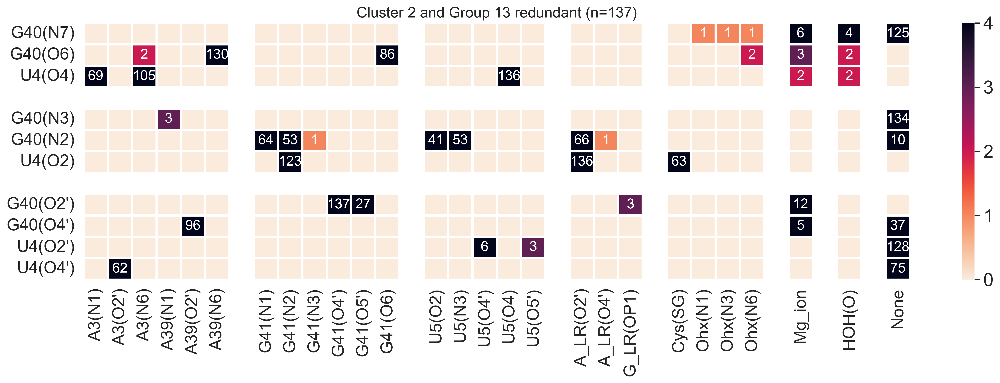

In [146]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (20,5), dpi = 400)
sns.set(font_scale=1.8)

C2_13_all_2.replace('None', np.nan, inplace=True)
C2_13_all_2 = C2_13_all_2.apply(pd.to_numeric)

annotations = C2_13_all_2.where((C2_13_all_2 != 0) & C2_13_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_13_all_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 2 and Group 13 redundant (n=137)", fontsize=16)

Text(0.5, 1.0, 'Cluster 2 and Group 13 non-redundant')

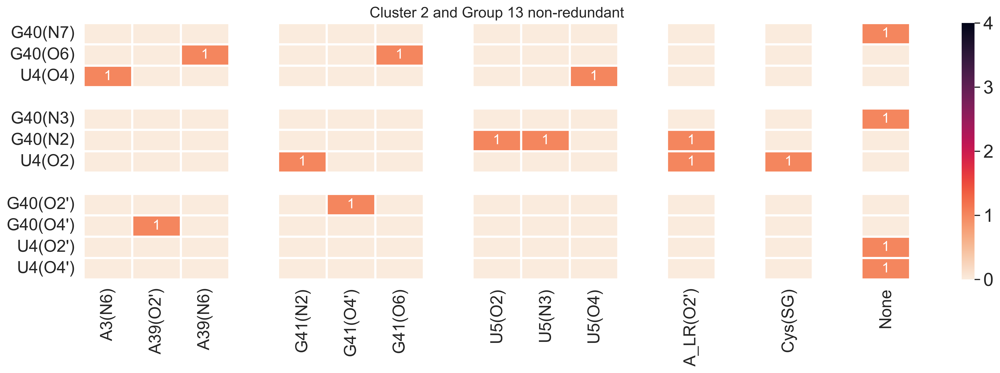

In [147]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (20,5), dpi = 400)
sns.set(font_scale=1.8)

C2_13_nr_2.replace('None', np.nan, inplace=True)
C2_13_nr_2 = C2_13_nr_2.apply(pd.to_numeric)

annotations = C2_13_nr_2.where((C2_13_nr_2 != 0) & C2_13_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C2_13_nr_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 2 and Group 13 non-redundant", fontsize=16)

# Cluster 3

## cluster 3 and Group 22

In [150]:
#cluster 3 --> group ID: 22
C3_22_all= sw_df1[(sw_df1['red_group_ID']==22)]
C3_22_all.index= np.arange(0, len(C3_22_all))

C3_22_nr= sw_df1[(sw_df1['red_group_ID']==22) & (sw_df1['representative']==1)]
C3_22_nr.index= np.arange(0, len(C3_22_nr))

In [151]:
C3_22_all_1= count_tert_intr(C3_22_all)
C3_22_nr_1= count_tert_intr(C3_22_nr)

working here
7SFR
471
481
working here
7MT2
471
481
G_N7_interactions
{'MG_LR(MG)': 2}
G_O6_interactions
{'MG_LR(MG)': 1, 'None': 1}
U_O4_interactions
{'C15(N4)': 2}
G_N3_interactions
{'None': 2}
G_N2_interactions
{'C15(N3)': 2, 'C15(O2)': 1, 'C5(O2)': 1}
U_O2_interactions
{'None': 2}
G_O4s_interactions
{'None': 2}
G_O2s_interactions
{"C5(O5')": 1, 'None': 1}
U_O4s_interactions
{'None': 2}
U_O2s_interactions
{'None': 2}
******************************************************
['4', '4']
['14', '14']
{'G4(N7)': {'MG_LR(MG)': 2}, 'G4(O6)': {'MG_LR(MG)': 1, 'None': 1}, 'U14(O4)': {'C15(N4)': 2}, 'G4(N3)': {'None': 2}, 'G4(N2)': {'C15(N3)': 2, 'C15(O2)': 1, 'C5(O2)': 1}, 'U14(O2)': {'None': 2}, "G4(O2')": {"C5(O5')": 1, 'None': 1}, "G4(O4')": {'None': 2}, "U14(O2')": {'None': 2}, "U14(O4')": {'None': 2}}
          MG_LR(MG)  None  C15(N4)  C15(N3)  C15(O2)  C5(O2)  C5(O5')
G4(N7)          2.0   NaN      NaN      NaN      NaN     NaN      NaN
G4(O6)          1.0   1.0      NaN      NaN      N

In [152]:
C3_22_all_2= add_aditional_cols(C3_22_all_1)
C3_22_nr_2= add_aditional_cols(C3_22_nr_1)

check here
Index(['MG_LR(MG)', 'None', 'C15(N4)', 'C15(N3)', 'C15(O2)', 'C5(O2)',
       'C5(O5')'],
      dtype='object')
['MG_LR(MG)']
['None']
         C5(O2) C5(O5') C15(O2) C15(N3) C15(N4)     Mg_ion     None
G4(N7)        0       0       0       0       0 NaN    2.0 NaN    0
G4(O6)        0       0       0       0       0 NaN    1.0 NaN  1.0
U14(O4)       0       0       0       0     2.0 NaN      0 NaN    0
0           NaN     NaN     NaN     NaN     NaN NaN    NaN NaN  NaN
G4(N3)        0       0       0       0       0 NaN      0 NaN  2.0
G4(N2)      1.0       0     1.0     2.0       0 NaN      0 NaN    0
U14(O2)       0       0       0       0       0 NaN      0 NaN  2.0
0           NaN     NaN     NaN     NaN     NaN NaN    NaN NaN  NaN
G4(O2')       0     1.0       0       0       0 NaN      0 NaN  1.0
G4(O4')       0       0       0       0       0 NaN      0 NaN  2.0
U14(O2')      0       0       0       0       0 NaN      0 NaN  2.0
U14(O4')      0       0       0       

Text(0.5, 1.0, 'Cluster 3 and Group 22 redundant (n=2)')

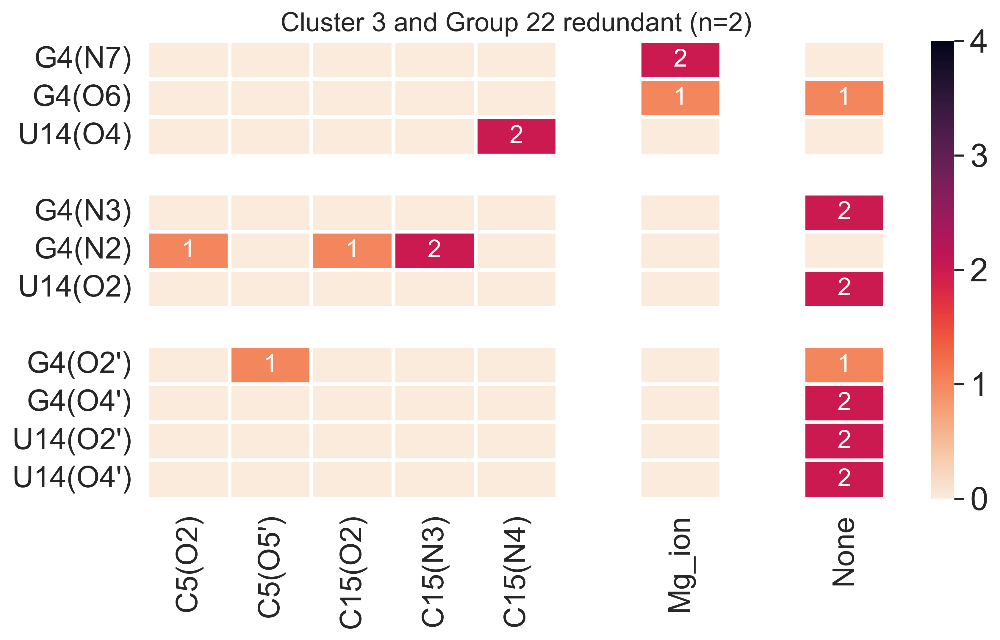

In [154]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (10,5), dpi = 400)
sns.set(font_scale=1.8)

C3_22_all_2.replace('None', np.nan, inplace=True)
C3_22_all_2 = C3_22_all_2.apply(pd.to_numeric)

annotations = C3_22_all_2.where((C3_22_all_2 != 0) & C3_22_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C3_22_all_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 3 and Group 22 redundant (n=2)", fontsize=16)

Text(0.5, 1.0, 'Cluster 3 and Group 22 non-redundant')

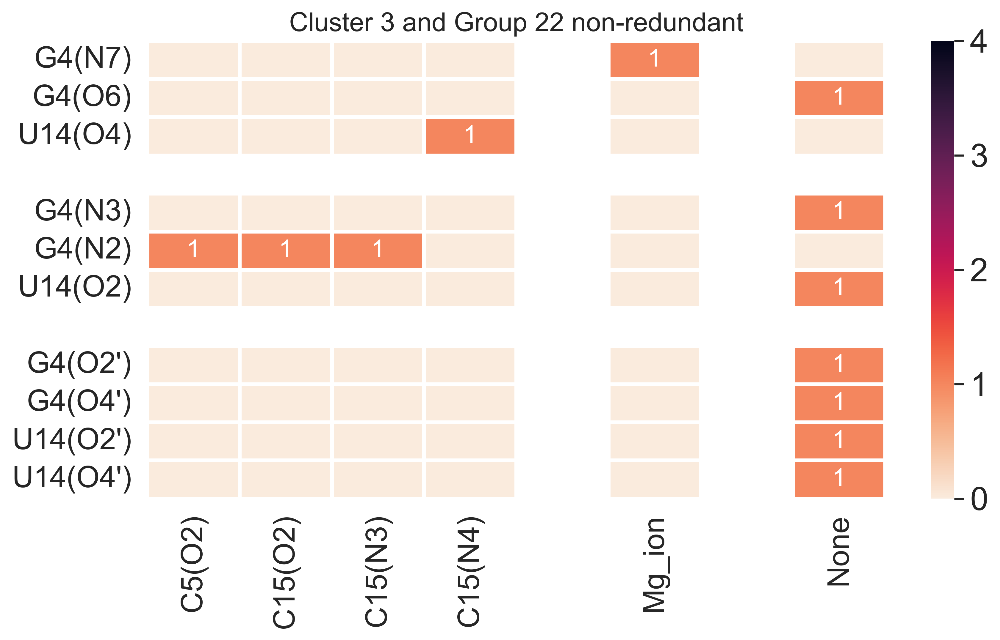

In [155]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (10,5), dpi = 400)
sns.set(font_scale=1.8)

C3_22_nr_2.replace('None', np.nan, inplace=True)
C3_22_nr_2 = C3_22_nr_2.apply(pd.to_numeric)

annotations = C3_22_nr_2.where((C3_22_nr_2 != 0) & C3_22_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C3_22_nr_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 3 and Group 22 non-redundant", fontsize=16)

# Cluster 4

## Cluster 4 and Group 17

In [156]:
#cluster 4 --> group ID: 17
C4_17_all= sw_df1[(sw_df1['red_group_ID']==17)]
C4_17_all.index= np.arange(0, len(C4_17_all))

C4_17_nr= sw_df1[(sw_df1['red_group_ID']==17) & (sw_df1['representative']==1)]
C4_17_nr.index= np.arange(0, len(C4_17_nr))

In [157]:
C4_17_all_1= count_tert_intr(C4_17_all)
C4_17_nr_1= count_tert_intr(C4_17_nr)

working here
6W6P
2318
2326
working here
6WU9
2318
2326
G_N7_interactions
{'None': 2}
G_O6_interactions
{'None': 2}
U_O4_interactions
{'None': 2}
G_N3_interactions
{'None': 2}
G_N2_interactions
{'None': 2}
U_O2_interactions
{'ASN_LR(OD1)': 2}
G_O4s_interactions
{'THR_LR(OG1)': 2}
G_O2s_interactions
{'ASP_LR(OD2)': 2, 'LEU_LR(O)': 2, 'ASP_LR(OD1)': 2}
U_O4s_interactions
{"A11(O2')": 2}
U_O2s_interactions
{"C13(O5')": 2, 'THR_LR(OG1)': 2}
******************************************************
['4', '4']
['12', '12']
{'G4(N7)': {'None': 2}, 'G4(O6)': {'None': 2}, 'U12(O4)': {'None': 2}, 'G4(N3)': {'None': 2}, 'G4(N2)': {'None': 2}, 'U12(O2)': {'ASN_LR(OD1)': 2}, "G4(O2')": {'ASP_LR(OD2)': 2, 'LEU_LR(O)': 2, 'ASP_LR(OD1)': 2}, "G4(O4')": {'THR_LR(OG1)': 2}, "U12(O2')": {"C13(O5')": 2, 'THR_LR(OG1)': 2}, "U12(O4')": {"A11(O2')": 2}}
          None  ASN_LR(OD1)  ASP_LR(OD2)  LEU_LR(O)  ASP_LR(OD1)  THR_LR(OG1)  \
G4(N7)     2.0          NaN          NaN        NaN          NaN          NaN  

In [158]:
C4_17_all_2= add_aditional_cols(C4_17_all_1)
C4_17_nr_2= add_aditional_cols(C4_17_nr_1)

check here
Index(['None', 'Asn(OD1)', 'Asp(OD2)', 'Leu(O)', 'Asp(OD1)', 'Thr(OG1)',
       'C13(O5')', 'A11(O2')'],
      dtype='object')
[]
['None']
         A11(O2')     C13(O5')     Asn(OD1) Asp(OD1) Asp(OD2) Leu(O) Thr(OG1)  \
G4(N7)          0 NaN        0 NaN        0        0        0      0        0   
G4(O6)          0 NaN        0 NaN        0        0        0      0        0   
U12(O4)         0 NaN        0 NaN        0        0        0      0        0   
0             NaN NaN      NaN NaN      NaN      NaN      NaN    NaN      NaN   
G4(N3)          0 NaN        0 NaN        0        0        0      0        0   
G4(N2)          0 NaN        0 NaN        0        0        0      0        0   
U12(O2)         0 NaN        0 NaN      2.0        0        0      0        0   
0             NaN NaN      NaN NaN      NaN      NaN      NaN    NaN      NaN   
G4(O2')         0 NaN        0 NaN        0      2.0      2.0    2.0        0   
G4(O4')         0 NaN        0 NaN      

Text(0.5, 1.0, 'Cluster 4 and Group 17 redundant (n=2)')

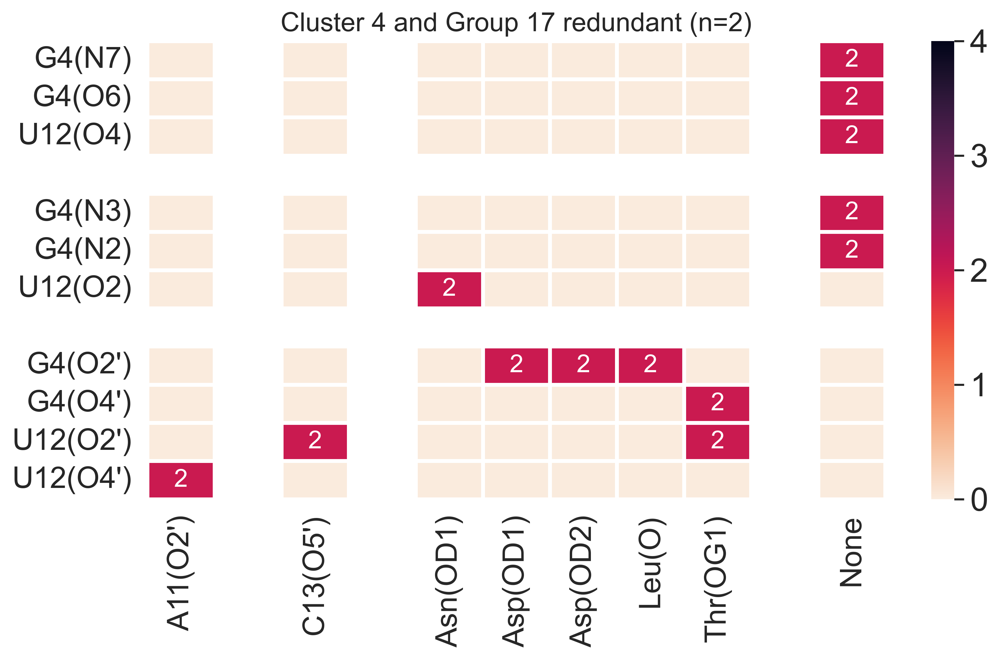

In [159]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (10,5), dpi = 400)
sns.set(font_scale=1.8)

C4_17_all_2.replace('None', np.nan, inplace=True)
C4_17_all_2 = C4_17_all_2.apply(pd.to_numeric)

annotations = C4_17_all_2.where((C4_17_all_2 != 0) & C4_17_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C4_17_all_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 4 and Group 17 redundant (n=2)", fontsize=16)

Text(0.5, 1.0, 'Cluster 4 and Group 17 non-redundant')

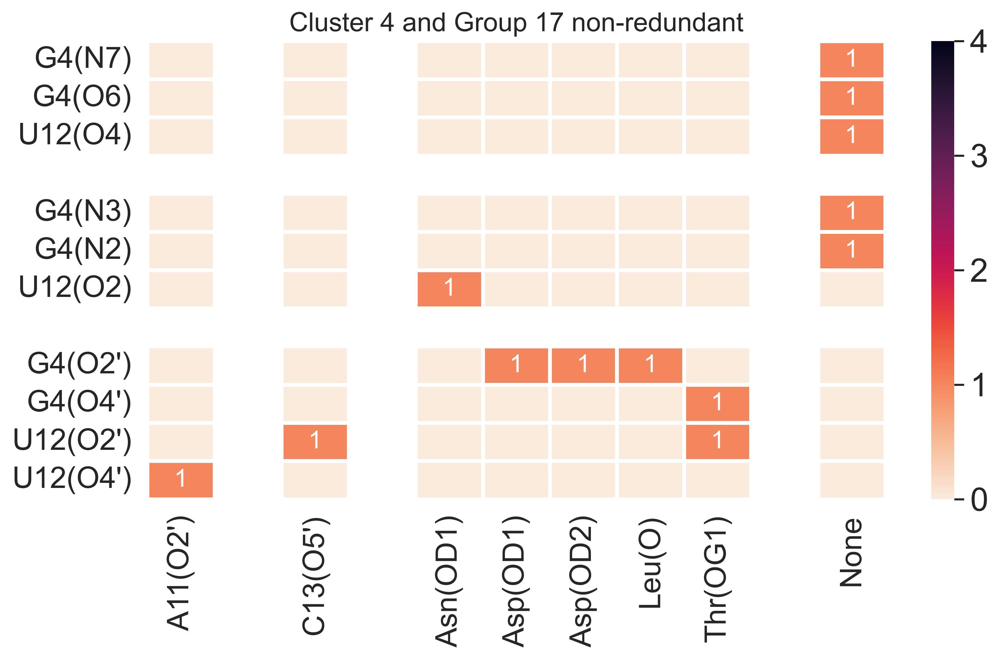

In [160]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (10,5), dpi = 400)
sns.set(font_scale=1.8)

C4_17_nr_2.replace('None', np.nan, inplace=True)
C4_17_nr_2 = C4_17_nr_2.apply(pd.to_numeric)

annotations = C4_17_nr_2.where((C4_17_nr_2 != 0) & C4_17_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C4_17_nr_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 4 and Group 17 non-redundant", fontsize=16)

## Cluster 4 and Group 18

In [161]:
#cluster 4 --> group ID: 18
C4_18_all= sw_df1[(sw_df1['red_group_ID']==18)]
C4_18_all.index= np.arange(0, len(C4_18_all))

C4_18_nr= sw_df1[(sw_df1['red_group_ID']==18) & (sw_df1['representative']==1)]
C4_18_nr.index= np.arange(0, len(C4_18_nr))

In [163]:
C4_18_all_1= count_tert_intr(C4_18_all)
C4_18_nr_1= count_tert_intr(C4_18_nr)

working here
6ZU1
2304
2312
working here
6YSS
2304
2312
working here
7NWT
2304
2312
working here
8EIU
2304
2312
working here
7NSQ
2304
2312
working here
7K00
2304
2312
working here
8AKN
2304
2312
working here
7SA4
2304
2312
working here
7O1A
2304
2312
working here
6I0Y
2304
2312
working here
4V9P
2304
2312
working here
8B0X
2308
2316
working here
7PJS
2304
2312
working here
7N31
2304
2312
working here
7O1C
2304
2312
working here
7OT5
2304
2312
working here
4V9O
2304
2312
working here
4V7U
2304
2312
working here
7N2U
2304
2312
working here
8EKC
2304
2312
working here
7OIF
2304
2312
working here
6ENF
2304
2312
working here
6QUL
2304
2312
working here
6ZTO
2304
2312
working here
5J8A
2304
2312
working here
4WF1
2304
2312
working here
4YBB
2304
2312
working here
6Y69
2304
2312
working here
4V6C
2304
2312
working here
7O19
2304
2312
working here
5J7L
2304
2312
working here
4V7T
2304
2312
working here
5J5B
2304
2312
working here
5IT8
2304
2312
working here
5J91
2304
2312
working here
6ZTP
23

In [164]:
C4_18_all_2= add_aditional_cols(C4_18_all_1)
C4_18_nr_2= add_aditional_cols(C4_18_nr_1)

check here
Index(['None', 'HOH_LR(O)', 'G3(N1)', 'G3(O6)', 'MG_LR(MG)', 'C13(N4)',
       'Asp(OD1)', 'Asp(OD2)', 'U12(O2)', 'C13(N3)', 'G4(N2)', 'Asn(ND2)',
       'G7(N2)', 'Met(O)', 'Asn(OD1)', 'Ser(OG)', 'Gly(N)', 'G3(O2')',
       'C13(O5')', 'Thr(OG1)', 'A11(O3')', 'A11(O2')'],
      dtype='object')
['MG_LR(MG)']
['HOH_LR(O)', '       ', 'None']
         A11(O2') A11(O3')     C13(N3) C13(N4) C13(O5')     G3(N1) G3(O2')  \
G4(N7)          0        0 NaN       0       0        0 NaN    2.0       0   
G4(O6)          0        0 NaN       0       0        0 NaN      0       0   
U12(O4)         0        0 NaN       0     2.0        0 NaN      0       0   
0             NaN      NaN NaN     NaN     NaN      NaN NaN    NaN     NaN   
G4(N3)          0        0 NaN       0       0        0 NaN      0       0   
G4(N2)          0        0 NaN     1.0       0        0 NaN      0       0   
U12(O2)         0        0 NaN       0       0        0 NaN      0       0   
0             NaN     

Text(0.5, 1.0, 'Cluster 4 and Group 18 redundant (n=36)')

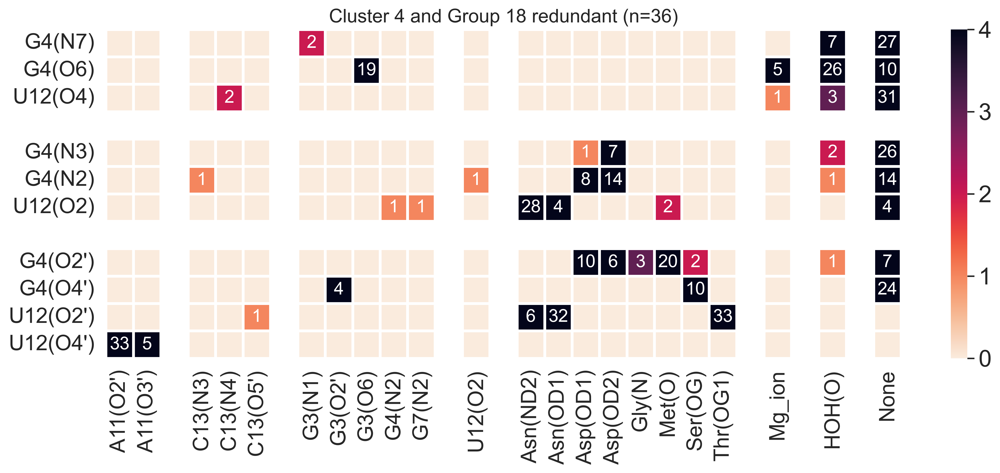

In [166]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (15,5), dpi = 400)
sns.set(font_scale=1.8)

C4_18_all_2.replace('None', np.nan, inplace=True)
C4_18_all_2 = C4_18_all_2.apply(pd.to_numeric)

annotations = C4_18_all_2.where((C4_18_all_2 != 0) & C4_18_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C4_18_all_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 4 and Group 18 redundant (n=36)", fontsize=16)

Text(0.5, 1.0, 'Cluster 4 and Group 18 non-redundant')

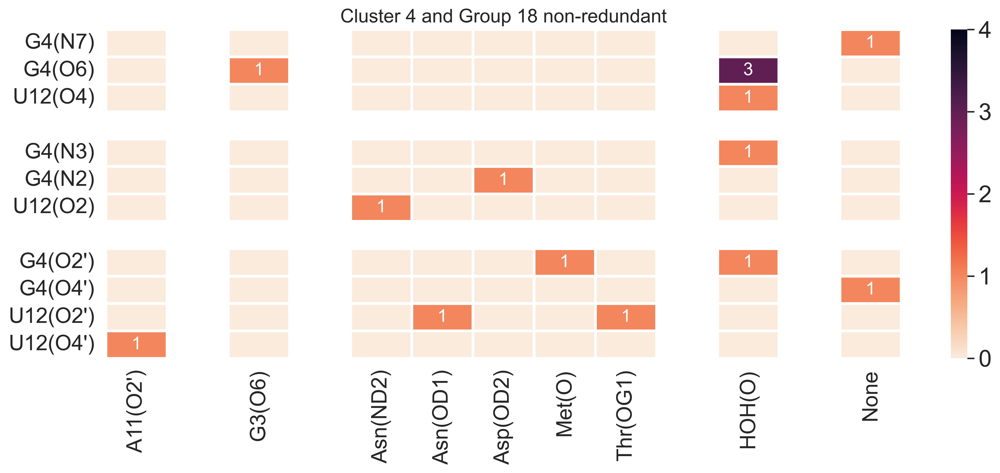

In [167]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (15,5), dpi = 400)
sns.set(font_scale=1.8)

C4_18_nr_2.replace('None', np.nan, inplace=True)
C4_18_nr_2 = C4_18_nr_2.apply(pd.to_numeric)

annotations = C4_18_nr_2.where((C4_18_nr_2 != 0) & C4_18_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C4_18_nr_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 4 and Group 18 non-redundant", fontsize=16)

## Cluster 4 and Group 21

In [169]:
#cluster 4 --> group ID: 21
C4_21_all= sw_df1[(sw_df1['red_group_ID']==21)]
C4_21_all.index= np.arange(0, len(C4_21_all))

C4_21_nr= sw_df1[(sw_df1['red_group_ID']==21) & (sw_df1['representative']==1)]
C4_21_nr.index= np.arange(0, len(C4_21_nr))

In [171]:
C4_21_all_1= count_tert_intr(C4_21_all)
C4_21_nr_1= count_tert_intr(C4_21_nr)

working here
7MT7
2542
2550
working here
7KGB
2542
2550
working here
7MSZ
2542
2550
G_N7_interactions
{'None': 2, 'G3(N3)': 1, 'G3(N1)': 1}
G_O6_interactions
{'None': 2, 'G3(O6)': 1}
U_O4_interactions
{'None': 3}
G_N3_interactions
{'ASP_LR(OD2)': 3}
G_N2_interactions
{'ASP_LR(OD2)': 3}
U_O2_interactions
{"C13(O4')": 1, 'None': 2, 'ASN_LR(ND2)': 1}
G_O4s_interactions
{'None': 2, "G3(O2')": 1}
G_O2s_interactions
{'None': 2, "A5(O5')": 1}
U_O4s_interactions
{"A11(O2')": 3}
U_O2s_interactions
{'None': 3}
******************************************************
['4', '4', '4']
['12', '12', '12']
{'G4(N7)': {'None': 2, 'G3(N3)': 1, 'G3(N1)': 1}, 'G4(O6)': {'None': 2, 'G3(O6)': 1}, 'U12(O4)': {'None': 3}, 'G4(N3)': {'ASP_LR(OD2)': 3}, 'G4(N2)': {'ASP_LR(OD2)': 3}, 'U12(O2)': {"C13(O4')": 1, 'None': 2, 'ASN_LR(ND2)': 1}, "G4(O2')": {'None': 2, "A5(O5')": 1}, "G4(O4')": {'None': 2, "G3(O2')": 1}, "U12(O2')": {'None': 3}, "U12(O4')": {"A11(O2')": 3}}
          None  G3(N3)  G3(N1)  G3(O6)  ASP_LR(

In [172]:
C4_21_all_2= add_aditional_cols(C4_21_all_1)
C4_21_nr_2= add_aditional_cols(C4_21_nr_1)

check here
Index(['None', 'G3(N3)', 'G3(N1)', 'G3(O6)', 'Asp(OD2)', 'C13(O4')',
       'Asn(ND2)', 'A5(O5')', 'G3(O2')', 'A11(O2')'],
      dtype='object')
[]
['None']
         A5(O5') A11(O2')     C13(O4')     G3(N1) G3(O2') G3(N3) G3(O6)       \
G4(N7)         0        0 NaN        0 NaN    1.0       0    1.0      0  NaN   
G4(O6)         0        0 NaN        0 NaN      0       0      0    1.0  NaN   
U12(O4)        0        0 NaN        0 NaN      0       0      0      0  NaN   
0            NaN      NaN NaN      NaN NaN    NaN     NaN    NaN    NaN  NaN   
G4(N3)         0        0 NaN        0 NaN      0       0      0      0  NaN   
G4(N2)         0        0 NaN        0 NaN      0       0      0      0  NaN   
U12(O2)        0        0 NaN      1.0 NaN      0       0      0      0  NaN   
0            NaN      NaN NaN      NaN NaN    NaN     NaN    NaN    NaN  NaN   
G4(O2')      1.0        0 NaN        0 NaN      0       0      0      0  NaN   
G4(O4')        0        0 NaN   

Text(0.5, 1.0, 'Cluster 4 and Group 21 redundant (n=3)')

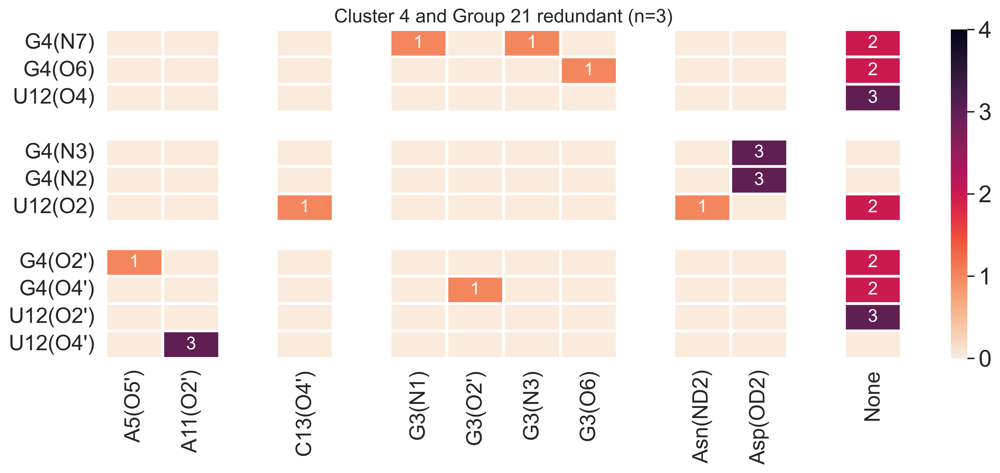

In [173]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (15,5), dpi = 400)
sns.set(font_scale=1.8)

C4_21_all_2.replace('None', np.nan, inplace=True)
C4_21_all_2 = C4_21_all_2.apply(pd.to_numeric)

annotations = C4_21_all_2.where((C4_21_all_2 != 0) & C4_21_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C4_21_all_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 4 and Group 21 redundant (n=3)", fontsize=16)

Text(0.5, 1.0, 'Cluster 4 and Group 21 non-redundant')

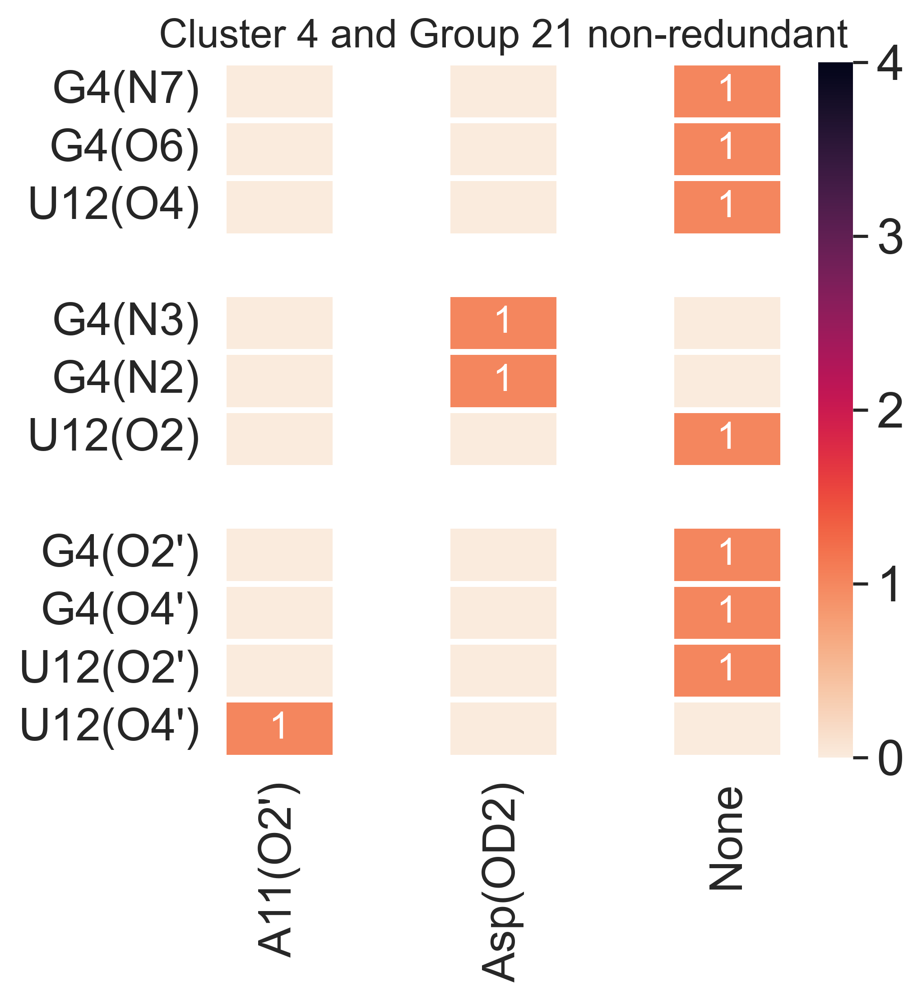

In [176]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (5,5), dpi = 400)
sns.set(font_scale=1.8)

C4_21_nr_2.replace('None', np.nan, inplace=True)
C4_21_nr_2 = C4_21_nr_2.apply(pd.to_numeric)

annotations = C4_21_nr_2.where((C4_21_nr_2 != 0) & C4_21_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C4_21_nr_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 4 and Group 21 non-redundant", fontsize=16)

## Cluster 4 and Group 24

In [177]:
#cluster 4 --> group ID: 24
C4_24_all= sw_df1[(sw_df1['red_group_ID']==24)]
C4_24_all.index= np.arange(0, len(C4_24_all))

C4_24_nr= sw_df1[(sw_df1['red_group_ID']==24) & (sw_df1['representative']==1)]
C4_24_nr.index= np.arange(0, len(C4_24_nr))

In [179]:
C4_24_all_1= count_tert_intr(C4_24_all)
C4_24_nr_1= count_tert_intr(C4_24_nr)

working here
7UNR
2291
2299
working here
7UNV
2291
2299
working here
7UNU
2291
2299
G_N7_interactions
{'None': 3}
G_O6_interactions
{'None': 2, 'G3(O6)': 1}
U_O4_interactions
{'None': 3}
G_N3_interactions
{'None': 3}
G_N2_interactions
{'None': 3}
U_O2_interactions
{'None': 3}
G_O4s_interactions
{'SER_LR(OG)': 3}
G_O2s_interactions
{'MET_LR(O)': 1, 'ASP_LR(OD2)': 2, 'GLY_LR(N)': 1, 'ASP_LR(OD1)': 2}
U_O4s_interactions
{"A11(O2')": 3}
U_O2s_interactions
{'THR_LR(OG1)': 3}
******************************************************
['4', '4', '4']
['12', '12', '12']
{'G4(N7)': {'None': 3}, 'G4(O6)': {'None': 2, 'G3(O6)': 1}, 'U12(O4)': {'None': 3}, 'G4(N3)': {'None': 3}, 'G4(N2)': {'None': 3}, 'U12(O2)': {'None': 3}, "G4(O2')": {'MET_LR(O)': 1, 'ASP_LR(OD2)': 2, 'GLY_LR(N)': 1, 'ASP_LR(OD1)': 2}, "G4(O4')": {'SER_LR(OG)': 3}, "U12(O2')": {'THR_LR(OG1)': 3}, "U12(O4')": {"A11(O2')": 3}}
          None  G3(O6)  MET_LR(O)  ASP_LR(OD2)  GLY_LR(N)  ASP_LR(OD1)  \
G4(N7)     3.0     NaN        NaN  

In [182]:
C4_24_all_2= add_aditional_cols(C4_24_all_1)
C4_24_nr_2= add_aditional_cols(C4_24_nr_1)

check here
Index(['None', 'G3(O6)', 'Met(O)', 'Asp(OD2)', 'Gly(N)', 'Asp(OD1)', 'Ser(OG)',
       'Thr(OG1)', 'A11(O2')'],
      dtype='object')
[]
['None']
         A11(O2')     G3(O6)     Asp(OD1) Asp(OD2) Gly(N) Met(O) Ser(OG)  \
G4(N7)          0 NaN      0 NaN        0        0      0      0       0   
G4(O6)          0 NaN    1.0 NaN        0        0      0      0       0   
U12(O4)         0 NaN      0 NaN        0        0      0      0       0   
0             NaN NaN    NaN NaN      NaN      NaN    NaN    NaN     NaN   
G4(N3)          0 NaN      0 NaN        0        0      0      0       0   
G4(N2)          0 NaN      0 NaN        0        0      0      0       0   
U12(O2)         0 NaN      0 NaN        0        0      0      0       0   
0             NaN NaN    NaN NaN      NaN      NaN    NaN    NaN     NaN   
G4(O2')         0 NaN      0 NaN      2.0      2.0    1.0    1.0       0   
G4(O4')         0 NaN      0 NaN        0        0      0      0     3.0   
U12(O2'

Text(0.5, 1.0, 'Cluster 4 and Group 24 redundant (n=3)')

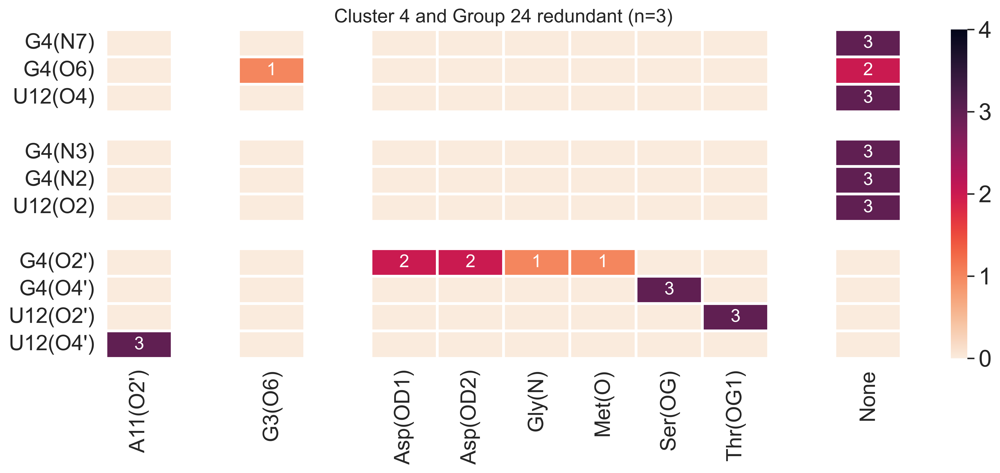

In [183]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (15,5), dpi = 400)
sns.set(font_scale=1.8)

C4_24_all_2.replace('None', np.nan, inplace=True)
C4_24_all_2 = C4_24_all_2.apply(pd.to_numeric)

annotations = C4_24_all_2.where((C4_24_all_2 != 0) & C4_24_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C4_24_all_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 4 and Group 24 redundant (n=3)", fontsize=16)

Text(0.5, 1.0, 'Cluster 4 and Group 24 non-redundant')

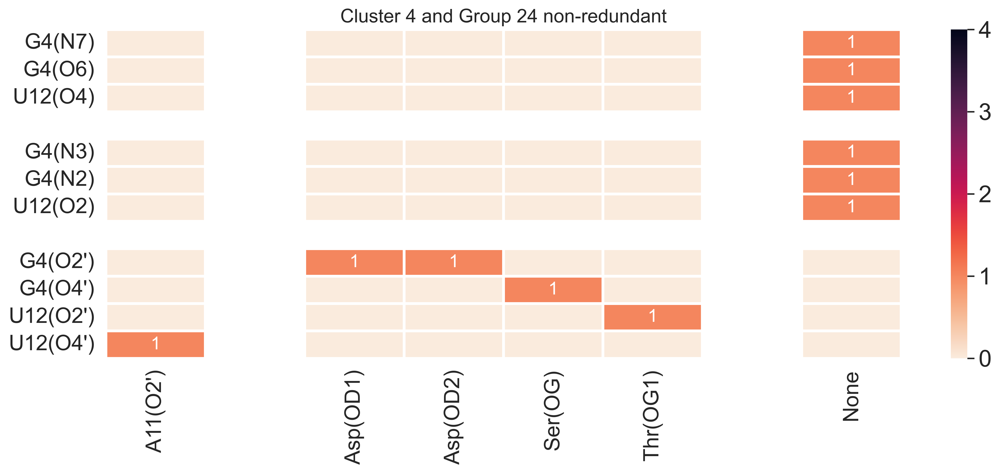

In [184]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (15,5), dpi = 400)
sns.set(font_scale=1.8)

C4_24_nr_2.replace('None', np.nan, inplace=True)
C4_24_nr_2 = C4_24_nr_2.apply(pd.to_numeric)

annotations = C4_24_nr_2.where((C4_24_nr_2 != 0) & C4_24_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C4_24_nr_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 4 and Group 24 non-redundant", fontsize=16)

## Cluster 4 and Group 31

In [178]:
#cluster 4 --> group ID: 31
C4_31_all= sw_df1[(sw_df1['red_group_ID']==31)]
C4_31_all.index= np.arange(0, len(C4_31_all))

C4_31_nr= sw_df1[(sw_df1['red_group_ID']==31) & (sw_df1['representative']==1)]
C4_31_nr.index= np.arange(0, len(C4_31_nr))

In [180]:
C4_31_all_1= count_tert_intr(C4_31_all)
C4_31_nr_1= count_tert_intr(C4_31_nr)

working here
7RQB
2304
2312
working here
4WQY
2316
2324
working here
5DOY
2304
2312
working here
4Y4O
2316
2324
working here
4Y4O
2304
2312
working here
4LNT
2304
2312
working here
4LNT
2304
2312
working here
8CVJ
2304
2312
working here
8CVJ
2304
2312
working here
4WPO
2316
2324
working here
5J4C
2316
2324
working here
5J8B
2315
2323
working here
6XHX
2304
2312
working here
5HAU
2315
2323
working here
1VY4
2304
2312
working here
4YZV
2304
2312
working here
4V51
2304
2312
working here
4V51
2304
2312
working here
5FDU
2316
2324
working here
1VY7
2304
2312
working here
6OF1
2304
2312
working here
4V95
2304
2312
working here
6O97
2304
2312
working here
4W2I
2304
2312
working here
6QNR
2317
2325
working here
6QNR
2304
2312
working here
7MD7
2304
2312
working here
7U2H
2304
2312
working here
4V8D
2304
2312
working here
7U2I
2304
2312
working here
7U2I
2304
2312
working here
7AZS
2319
2327
working here
6XHV
2304
2312
working here
5HCP
2315
2323
working here
8CVK
2304
2312
working here
1VY5
23

In [181]:
C4_31_all_2= add_aditional_cols(C4_31_all_1)
C4_31_nr_2= add_aditional_cols(C4_31_nr_1)

check here
Index(['None', 'HOH_LR(O)', 'G3(O6)', 'G3(N1)', 'MG_LR(MG)', 'C13(N4)',
       'K_LR(K)', 'A11(OP1)', 'C13(O2)', 'Asp(OD2)', 'Asp(OD1)', 'C13(N3)',
       'U12(O2)', 'Gly(O)', 'G4(N2)', 'Asn(ND2)', 'G7(N2)', 'Asn(OD1)',
       'Leu(O)', 'Gly(N)', 'A5(O5')', 'G3(O2')', 'G3(N3)', 'Thr(OG1)',
       'A11(O3')', 'A11(O2')'],
      dtype='object')
['MG_LR(MG)']
['HOH_LR(O)', '       ', 'None']
         A5(O5') A11(OP1) A11(O2') A11(O3')     C13(O2) C13(N3) C13(N4)      \
G4(N7)         0        0        0        0 NaN       0       0       0 NaN   
G4(O6)         0        0        0        0 NaN       0       0     7.0 NaN   
U12(O4)        0      6.0        0        0 NaN       0       0    15.0 NaN   
0            NaN      NaN      NaN      NaN NaN     NaN     NaN     NaN NaN   
G4(N3)         0        0        0        0 NaN    10.0     2.0       0 NaN   
G4(N2)         0        0        0        0 NaN     4.0    19.0       0 NaN   
U12(O2)        0        0        0        0 

Text(0.5, 1.0, 'Cluster 4 and Group 31 redundant (n=80)')

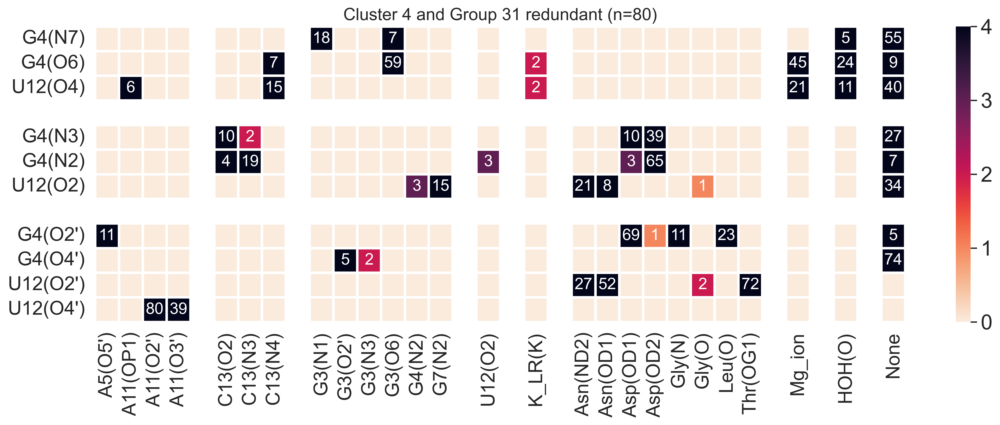

In [186]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (17,5), dpi = 400)
sns.set(font_scale=1.8)

C4_31_all_2.replace('None', np.nan, inplace=True)
C4_31_all_2 = C4_31_all_2.apply(pd.to_numeric)

annotations = C4_31_all_2.where((C4_31_all_2 != 0) & C4_31_all_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C4_31_all_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 4 and Group 31 redundant (n=80)", fontsize=16)

Text(0.5, 1.0, 'Cluster 4 and Group 31 non-redundant')

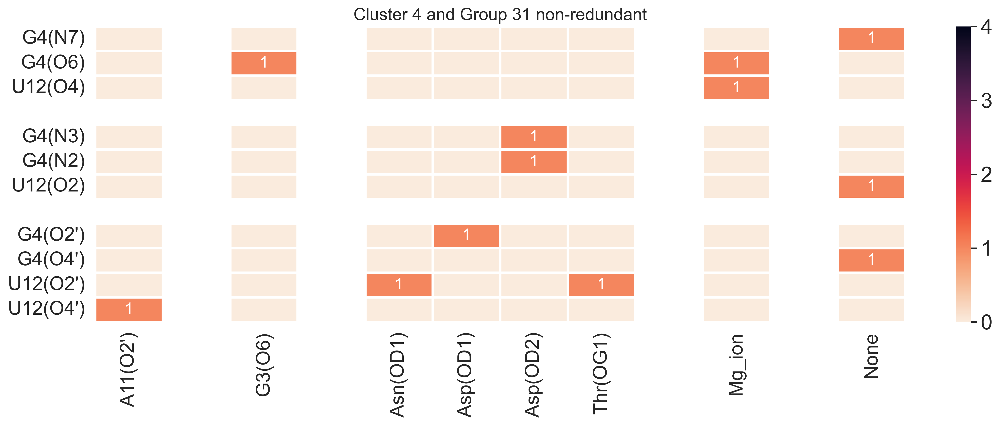

In [187]:
sns.set(style= 'white', font= "Arial")
fig, ax = plt.subplots(figsize = (17,5), dpi = 400)
sns.set(font_scale=1.8)

C4_31_nr_2.replace('None', np.nan, inplace=True)
C4_31_nr_2 = C4_31_nr_2.apply(pd.to_numeric)

annotations = C4_31_nr_2.where((C4_31_nr_2 != 0) & C4_31_nr_2.notna()).fillna('') 
annotations = annotations.applymap(lambda x: str(int(float(x))) if x else '')

ax = sns.heatmap(C4_31_nr_2,annot= annotations, fmt='', annot_kws={"size": 15, "color": "white"}, cmap='rocket_r', linewidth=2, linecolor='white', vmin=0, vmax=4, cbar_kws={'pad': .05, 'ticks': [0, 1, 2, 3, 4]})

ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, fontsize = 18);
ax.set_yticklabels(ax.get_yticklabels(), rotation = 0, fontsize = 18);
#plt.axvline(x=16.5, color='black', linestyle='-', linewidth=2) 
#plt.title('                                                                              n', pad= 10);
#plt.savefig("fig_8_C3_non_WCF.pdf", format="pdf", bbox_inches="tight", dpi = 1400)

plt.title("Cluster 4 and Group 31 non-redundant", fontsize=16)

In [188]:
from scipy.cluster.hierarchy import linkage, dendrogram

# Example data
data = [[1, 2], [3, 4], [5, 6], [7, 8]]

# Perform hierarchical clustering
Z = linkage(data, method='ward')

# Linkage matrix
print("Linkage matrix:\n", Z)

# Find the distance between specific clusters
for i, (c1, c2, dist, _) in enumerate(Z):
    print(f"Distance between clusters {int(c1)} and {int(c2)}: {dist}")


Linkage matrix:
 [[0.         1.         2.82842712 2.        ]
 [2.         3.         2.82842712 2.        ]
 [4.         5.         8.         4.        ]]
Distance between clusters 0 and 1: 2.8284271247461903
Distance between clusters 2 and 3: 2.8284271247461903
Distance between clusters 4 and 5: 7.999999999999999
